# Style-Transfer and Texture Synthesis

In [25]:
! git clone https://github.com/Elizabeth1997/img.git
  # upload the dataset on the github first, keep it public, otherwise SSH is needed (I just have no idea about how to do by SSH...)
  # using the command to download the dataset into the current directory, and that's it

Cloning into 'img'...
remote: Enumerating objects: 40, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (40/40), done.
remote: Total 40 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (40/40), done.


In this project, the goal is to reimplement certain aspects of two papers for style transfer and texture synthesis.

# Image Style Transfer Using Convolutional Neural Networks [1]

The goal of the approach described in [1] is to transfer the style of a style image $\vec{a}$ to a content image $\vec{p}$ by gradually applying changes to a target image $\vec{x}$ that is initially showing white noise (or for performance reasons the content image $\vec{p}$) such that $\vec{x}$ converges to an image that shows the content of $\vec{p}$ (e.g. KAUST) in the style of $\vec{a}$ (similar colors, brush strokes etc.) (cf. figure below) Details about the method are provided in Appendix A.

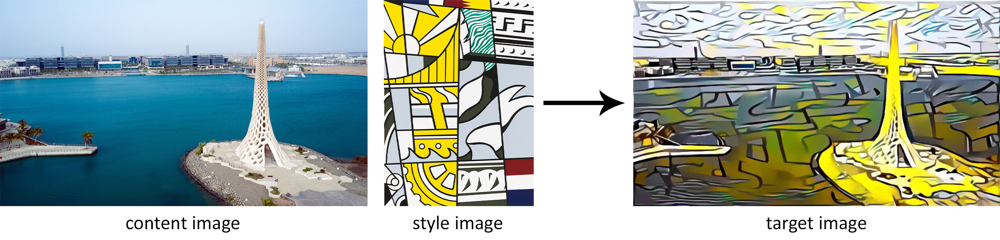

In [0]:
from IPython.display import Image
Image('img/overview.jpg', retina=True)

## Library imports and definition of some helper functions (do not change anything)

In [0]:
# import all needed resources
%matplotlib inline

from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np
import time

import torch
import torch.nn as nn
import torch.optim as optim
import requests
from torchvision import transforms, models

In [0]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [0]:
def load_image(img_path, max_size = 400, shape = None):
    
    ''' Load and downscale an image if the shorter side is longer than <max_size> px '''
    
    if "http" in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(img_path).convert('RGB')
    
    if min(image.size) > max_size:
        size = max_size
    else:
        size = min(image.size)
    
    if shape is not None:
        size = shape
    
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # discard alpha channel (:3) and append the batch dimension (unsqueeze(0))
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

In [0]:
# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Convert a PyTorch tensor to a NumPy image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

In [0]:
''' Define and load corresponding content/style pairs '''

content_files = ['kaust', 'tesla', 'hamilton', 'mandela']
style_files = ['starry_night', 'jesuiten', 'scream', 'ben_passmore']
ref_vgg_files = ['vgg0_ref', 'vgg1_ref', 'vgg2_ref', 'vgg3_ref']
ref_resnet_files = ['res0_ref', 'res1_ref', 'res2_ref', 'res3_ref']

# load in content and style images
content = [load_image('img/content/' + c + '.jpg').to(device) for c in content_files]

# Resize style images to match corresponding content, makes code easier
style = [load_image('img/style/' + s + '.jpg', shape=content[n].shape[-2:]).to(device) for n, s in enumerate(style_files)]

ref_vgg =  [load_image('img/ref/' + c + '.jpg').to(device) for c in ref_vgg_files]
ref_res =  [load_image('img/ref/' + c + '.jpg').to(device) for c in ref_resnet_files]

# Create Target image and prepare it for change (requires_grad_(True))
# Starting with the content image and applying the style is usually faster than starting from a random image

# Target Image = Content Image
target = [c.clone().requires_grad_(True).to(device) for c in content]

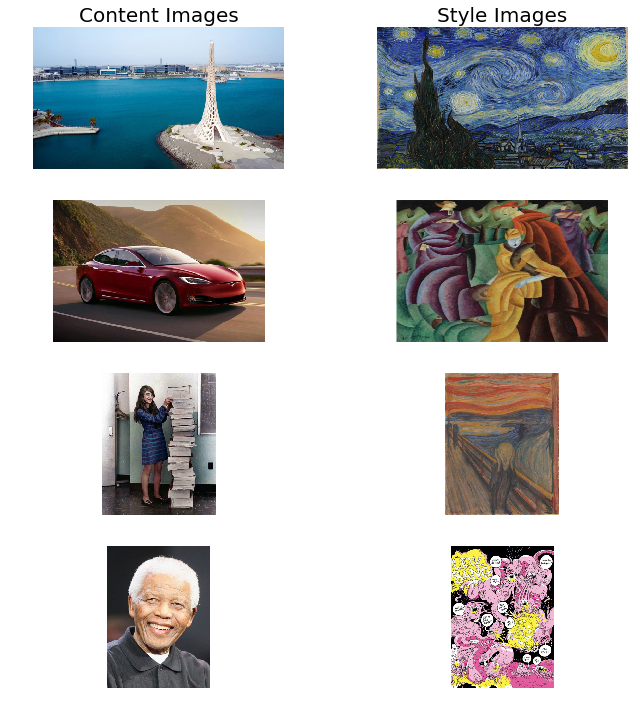

In [31]:
# display the images
num_pairs = len(content)
fig, axs = plt.subplots(num_pairs, 2, figsize=(10, 10))

axs[0, 0].set_title('Content Images', fontsize=20)
axs[0, 1].set_title('Style Images', fontsize=20)
#axs[0, 2].set_title('Target Images', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(content[row]))
        axs[row, 1].imshow(im_convert(style[row]))
        # axs[row, 2].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

In [0]:
def get_features(image, model, layers):
    # Run an image forward through a model and get the features for a set of layers.
        
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
    return features
# f = get_features(target[0], vgg, layers_vgg)

## Task 1: Calculate the $d \times d$ gram matrix corresponding to a $1 \times d \times h \times w$ tensor (10 points)

As described in [1], the style of an image can be represented by the Gram matrix of a layer consisting of a set of features maps.

In [0]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    # TODO Task 1: Implement the computation of the Gram Matrix
    
    ## get the batch_size, depth, height, and width of the Tensor
    ## reshape it, so we're multiplying the features for each channel
    ## calculate the gram matrix
    batch_size, depth, height, width = tensor.shape
#     batch_size = len(tensor)
#     depth = len(tensor[0])
#     height = len(tensor[0][0])
#     width = len(tensor[0][0][0])
    # cx: vectoried the tensor, reshape the original tensor to a (h*w) by d matrix
    # error t() expects a tensor with <= 2 dimensions, but self is 3D
    # how is it possible to train a mini-batch? I think the input should always have one image
#     tensor = torch.reshape(tensor, (batch_size,height*width,depth))
    tensor = torch.reshape(tensor, (height*width,depth)) # vectorized every feature map
  
    # cx: transpose the tensor
    tensor_t = torch.t(tensor)
    # cx: do inner procuct between any two vectorized feature maps, which form the gram matrix that represents the style of the image
#     gram = None
    gram = torch.mm(tensor_t,tensor) 
    return gram

In [0]:
# cx.test the size of gram_matrix is depth by depth
test_tensor = torch.randn(1,8,12,12)
print(gram_matrix(test_tensor).shape)

torch.Size([8, 8])


## Task 2: Complete the Training Function (15 points)

In order to complete this task, you might want to refer to the paper [1] and to the Appendix A. Note that the equations in Appendix A slightly differ from the originals in the paper. However, we highly recommend the equations in Appendix A since the equations in the paper seem to be inconsistent to the original implementation of the authors and are obviously missing normalization.

In [0]:
# print(type(content_features_vgg[0]))
# for key, value in content_features_vgg[0].items():
#   print(value.shape)
print((content_features_vgg[0]['conv4_2']))

In [0]:
# style_grams_vgg[0]
for key, value in style_grams_vgg[0].items():
  print(value.shape)
print((style_grams_vgg[0]['conv5_1']).shape)

In [0]:
def run_model(model, layers, target, content_features, style_grams, content_layer, style_weights, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.003):
    
    # for displaying the loss values, intermittently
    show_every = 500

    # iteration hyperparameters
    optimizer = optim.Adam([target], lr=lr)
    
    # Values of the learning curve
    learning_curve = np.zeros(steps)
    
    print(learning_curve.shape)

    start = time.time()

    for ii in range(1, steps+1):

        
        ## TODO Task 2: get the features from the target image w.r.t. the provided model and the required layers
        # target should be represented as a tensor object here, layers as well 
        target_image = im_convert(target)
        # cx: get_features(target, model, layers) will return a dict whose key is the name of layer and value is the corresponding feature of target image gotten
        target_features = get_features(target, model, layers)
        
        ## TODO Task 2: calculate the content loss (refer to Appendix A for details about the formula)
        # cx: layers is a list that stores a set of layers
#         content_loss = {}
        content_loss = 0
#         for name in layers:
#           features[layers[name]] = x
          # content_layer = 'conv4_2'
        # only calculate one layer
        f_content = target_features[content_layer].view(-1)
#         print(f.shape)  the shape of f and p are both 1x512x50x88
        p_content = content_features[content_layer].view(-1)
        
        content_difference = f_content-p_content
        content_squares = content_difference ** 2
#         content_squares = content_squares.view(-1) # strech
#         content_mean_of_squares = torch.mean(content_squares)
        content_loss += torch.mean(content_squares)
#           content_loss[layers[name]] = mean_of_squares


        # the style loss
        # initialize the style loss to 0
        style_loss = 0
        
        # then add to it for each layer's gram matrix loss
        for layer in style_weights:
          
            s_weight = style_weights[layer]   # style_weights_vgg is a dict

            target_feature = target_features[layer]

            _, d, h, w = target_feature.shape # underscore means we don't care about the value of the first variable returned

            
            ## TODO Task 2: Calculate the target gram matrix
#             target_gram = gram_matrix(torch.reshape(target_feature, (1,d,h,w)))
            target_gram = gram_matrix(target_feature).view(-1) # the size of this gram matrix is d by d

            ## TODO Task 2: get the "style" style representation
#             content_feature = content_features[layer]
#             style_gram = gram_matrix(content_feature)
            
            style_gram = style_grams[layer].view(-1)
            ## TODO Task 2: Calculate the style loss for one layer, weighted appropriately (again, refer to Appendix A for details)
            style_difference = target_gram - style_gram
            style_squares = style_difference * style_difference
#             style_squares = style_squares.view(-1) # strech
#             style_mean_of_squares = torch.mean(style_squares)
            layer_style_loss = torch.mean(style_squares)
            
            # cx: it doesn't give the weight for each layer's style loss. In other word, the weights of each layer's style loss are equal to one
            # add to the style loss
            style_loss += s_weight * (layer_style_loss / (h * w)**2)

            
        # TODO Task 2: calculate the *total* loss
        total_loss = content_weight*content_loss + style_weight*style_loss


        learning_curve[ii - 1] = total_loss

        # update your target image
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        # display intermediate images and print the loss
        if  ii % show_every == 0:
            print('Total loss: ', total_loss.item())
            print('Weighted Content loss: ', content_weight * content_loss.item())
            print('Weighted Style loss: ', style_weight * style_loss.item())

            end = time.time()
            print('Time [s]: ', (end - start))
            plt.imshow(im_convert(target))
            plt.show()

    end = time.time()
    print('Total Time [s]: ', (end - start))
    
    return [target, learning_curve]

## VGG Network
We want to use the VGG-19 network for feature extraction first, since it was also suggestend by the authors of [1].

In [34]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
# cx: vgg19 has three more convolutional layers than vgg16
# transfer learning : remove fully connected layers
vgg = models.vgg19(pretrained=True).features.to(device)

# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 574673361/574673361 [00:06<00:00, 90875695.47it/s] 


In [0]:
# print out VGG19 structure so you can see the numbers of various layers
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace)
  (18): MaxPool2d(kernel_size=2, stride=2, padding=0, 

## Task 3: Complete the mapping from VGG layer numbers to layer names (6 points)

Refer to the paper [1] to identify the layers that are suitable for content and style representation and complete the dictionary below that maps from layer numbers to layer names.
You may also want to print the VGG network using the print command above to see the layer numbers together with the corresponding layers.

In [0]:
## TODO Task 3: Complete mapping layer names of PyTorch's VGGNet to names from the paper
## Need the layers for the content and style representations of an image

# definition of all the layers needed from VGG net
# # content representation
# on layer ‘conv4 2’ and the style representation on layers
# ‘conv1 1’, ‘conv2 1’, ‘conv3 1’, ‘conv4 1’ and ‘conv5 1’
layers_vgg = {'0': 'conv1_1', '5': 'conv2_1', '10': 'conv3_1', '19': 'conv4_1', '21': 'conv4_2', '28':'conv5_1'}
# layers_vgg = {'0': 'conv1_1', '1': 'conv2_1', '2': 'conv3_1', '3': 'conv4_1', '4': 'conv4_2', '5':'conv5_1'}

In [0]:
# get content and style features only once before training
content_features_vgg = [get_features(c, vgg, layers_vgg) for c in content]
style_features_vgg = [get_features(s, vgg, layers_vgg) for s in style]

# calculate the gram matrices for each layer of our style representation
#style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}
style_grams_vgg = [{layer: gram_matrix(s[layer]) for layer in s} for s in style_features_vgg]

In [0]:
# Weights for VGG net
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` which is used for content representation

style_weights_vgg = {'conv1_1': 1.,
                     'conv2_1': 0.8,
                     'conv3_1': 0.5,
                     'conv4_1': 0.3,
                     'conv5_1': 0.1}

## Task 4: Styler Transfer using the VGG network (12 points - 4 examples, 3 points each)

Experiment with different weights for style (1.0e3, 1.0e6, 1.0e9, 1.0e12), different numbers of steps (e.g. 500, 1000, 2000) and different learning rates (e.g. 0.1, 0.01, 0.001) to find a set of parameters with which you can create a stylized image that looks similar to the provided reference solution as fast / efficient as possible. Plot the learning curve and put both the learning curvevs and training times together with the final result to your final report.

In [0]:
print(type(target[0]))

<class 'torch.Tensor'>


In [0]:
style_weights_list = [1.0e3, 1.0e6, 1.0e9, 1.0e12]
number_of_steps_list = [500, 1000, 2000]
learning_rates_list = [0.1, 0.01, 0.001]
# 1.0e9  1000 0.01

## 1st Example

### style_weight = 1.0e3, steps = 1000, lr = 0.01 

(1000,)
Total loss:  22.651859283447266
Weighted Content loss:  3.877356767654419
Weighted Style loss:  18.774501979351044
Time [s]:  171.4847469329834


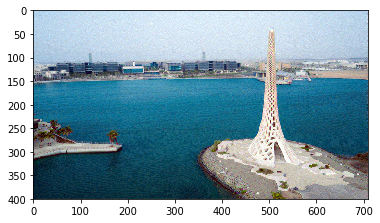

Total loss:  12.40468978881836
Weighted Content loss:  3.665076971054077
Weighted Style loss:  8.739612996578217
Time [s]:  343.71480202674866


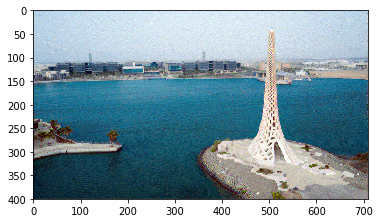

Total Time [s]:  344.052325963974


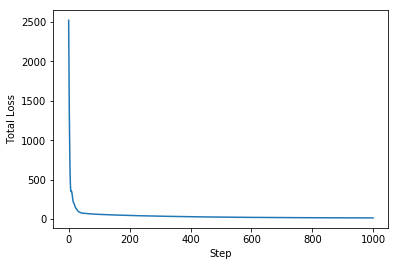

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e3, steps = 1000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e6, steps = 1000, lr = 0.01 

(1000,)
Total loss:  5405.39501953125
Weighted Content loss:  5.221556186676025
Weighted Style loss:  5400.173366069794
Time [s]:  175.5653042793274


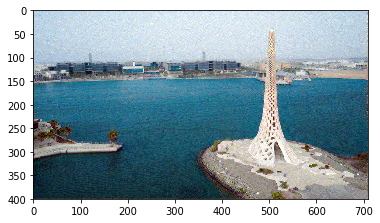

Total loss:  4395.65478515625
Weighted Content loss:  5.515009880065918
Weighted Style loss:  4390.139598399401
Time [s]:  351.4354467391968


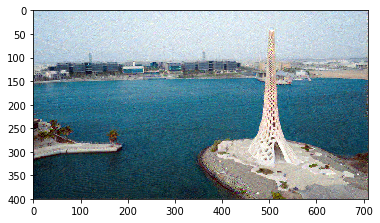

Total Time [s]:  351.7595932483673


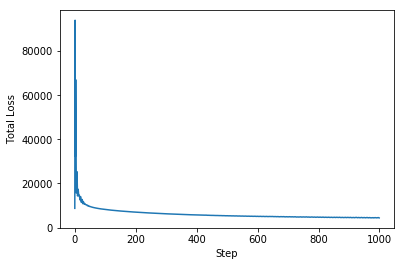

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e6, steps = 1000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e9, steps = 1000, lr = 0.01 

(1000,)
Total loss:  4022915.5
Weighted Content loss:  5.671672821044922
Weighted Style loss:  4022909.7940027714
Time [s]:  171.60665941238403


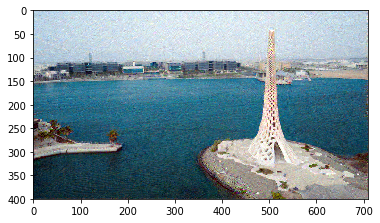

Total loss:  3662990.0
Weighted Content loss:  5.787848949432373
Weighted Style loss:  3662984.3525588512
Time [s]:  344.410968542099


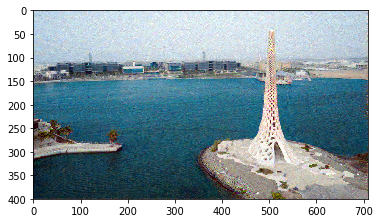

Total Time [s]:  344.74069833755493


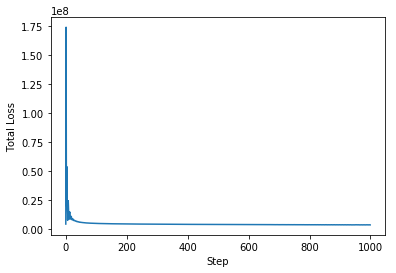

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 1000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 1000, lr = 0.01 

(1000,)
Total loss:  3492978176.0
Weighted Content loss:  5.861899375915527
Weighted Style loss:  3492978168.6514616
Time [s]:  175.13957166671753


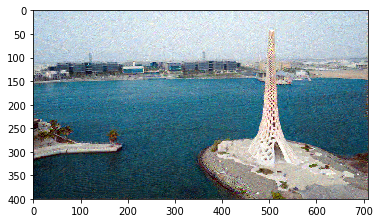

Total loss:  3309395200.0
Weighted Content loss:  5.91914176940918
Weighted Style loss:  3309395164.2513275
Time [s]:  351.66834926605225


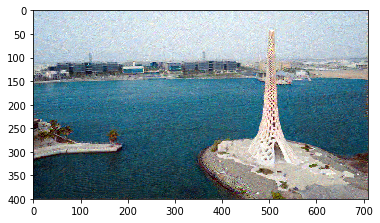

Total Time [s]:  352.00964283943176


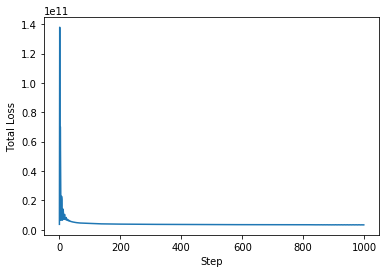

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 1000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e3, steps = 2000, lr = 0.01

(2000,)
Total loss:  7.917276382446289
Weighted Content loss:  4.057826042175293
Weighted Style loss:  3.859450574964285
Time [s]:  171.71369981765747


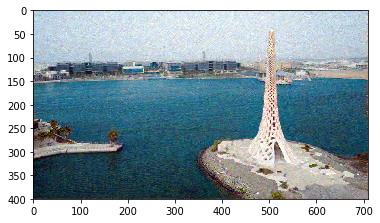

Total loss:  7.547591209411621
Weighted Content loss:  3.8103630542755127
Weighted Style loss:  3.7372284568846226
Time [s]:  344.30042147636414


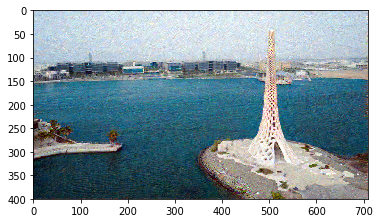

Total loss:  7.413755416870117
Weighted Content loss:  3.69452166557312
Weighted Style loss:  3.7192339077591896
Time [s]:  516.58748960495


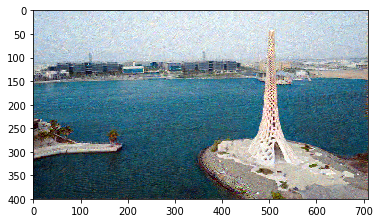

Total loss:  7.186789512634277
Weighted Content loss:  3.590388059616089
Weighted Style loss:  3.596401307731867
Time [s]:  688.8035969734192


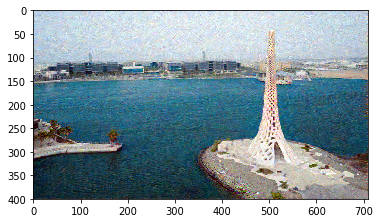

Total Time [s]:  689.1482040882111


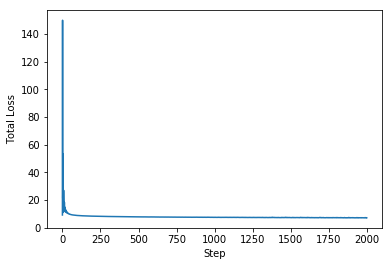

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e3, steps = 2000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e6, steps = 2000, lr = 0.01 

(2000,)
Total loss:  3011.630615234375
Weighted Content loss:  4.89369010925293
Weighted Style loss:  3006.736747920513
Time [s]:  173.1667025089264


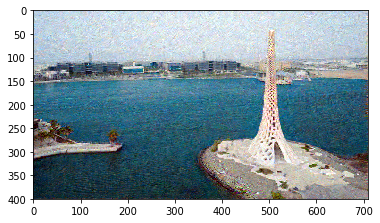

Total loss:  2864.437255859375
Weighted Content loss:  5.09214448928833
Weighted Style loss:  2859.34517160058
Time [s]:  348.5760259628296


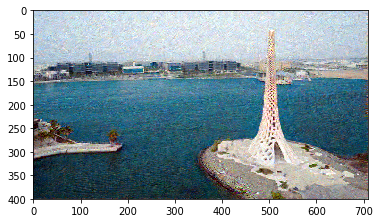

Total loss:  2816.524169921875
Weighted Content loss:  5.188902378082275
Weighted Style loss:  2811.3352600485086
Time [s]:  523.7551164627075


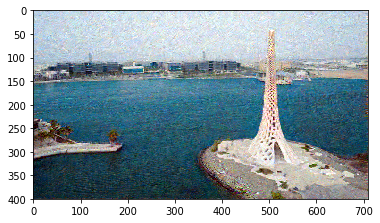

Total loss:  2815.25634765625
Weighted Content loss:  5.293187141418457
Weighted Style loss:  2809.9631890654564
Time [s]:  699.4912323951721


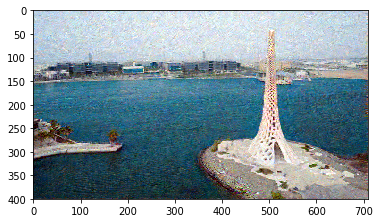

Total Time [s]:  699.8351697921753


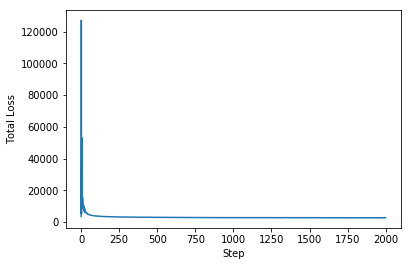

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e6, steps = 2000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e9, steps = 2000, lr = 0.01 

(2000,)
Total loss:  2653498.0
Weighted Content loss:  5.350852966308594
Weighted Style loss:  2653492.847457528
Time [s]:  171.44987988471985


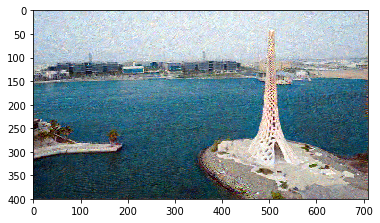

Total loss:  2564832.25
Weighted Content loss:  5.398507118225098
Weighted Style loss:  2564826.747402549
Time [s]:  344.4146797657013


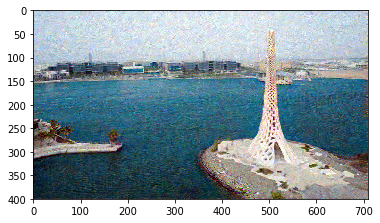

Total loss:  2598273.25
Weighted Content loss:  5.457531452178955
Weighted Style loss:  2598267.747089267
Time [s]:  516.7786412239075


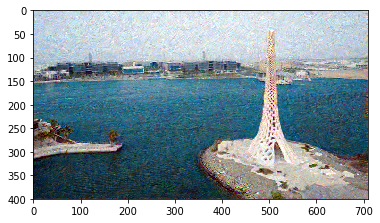

Total loss:  2598487.0
Weighted Content loss:  5.452607154846191
Weighted Style loss:  2598481.485620141
Time [s]:  689.3570041656494


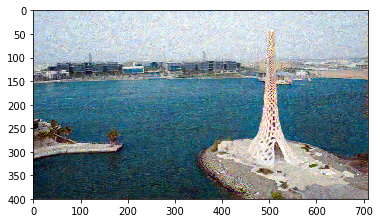

Total Time [s]:  689.6957774162292


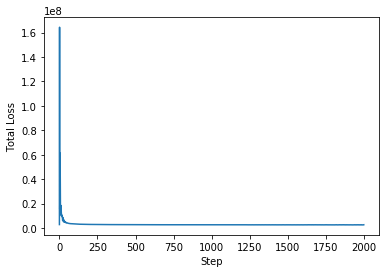

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 2000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 2000, lr = 0.01 

(2000,)
Total loss:  24087134208.0
Weighted Content loss:  6.773184776306152
Weighted Style loss:  24087134748.69728
Time [s]:  181.64196944236755


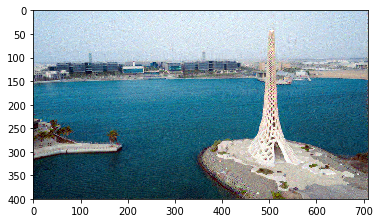

Total loss:  19303417856.0
Weighted Content loss:  6.89515495300293
Weighted Style loss:  19303418695.926666
Time [s]:  363.8548014163971


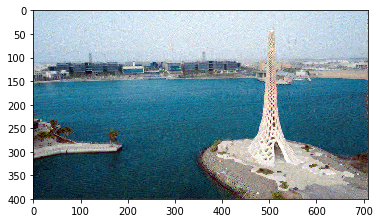

Total loss:  16885265408.0
Weighted Content loss:  6.997235298156738
Weighted Style loss:  16885265707.969666
Time [s]:  545.8323647975922


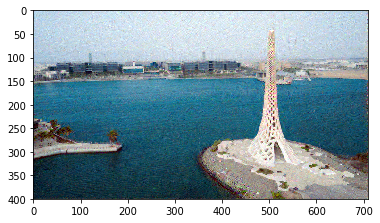

Total loss:  15905659904.0
Weighted Content loss:  7.075796127319336
Weighted Style loss:  15905659645.795822
Time [s]:  727.7758955955505


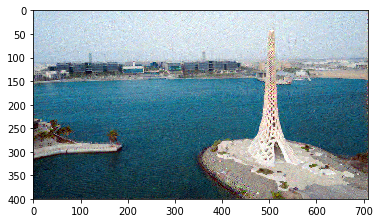

Total Time [s]:  728.08207654953


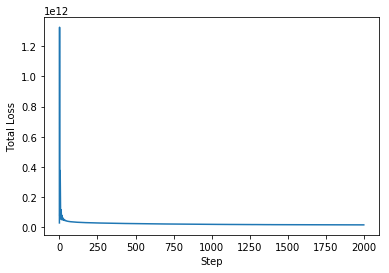

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 2000, lr = 0.01)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

(3000,)
Total loss:  40709435392.0
Weighted Content loss:  5.201370716094971
Weighted Style loss:  40709435939.78882
Time [s]:  179.30524802207947


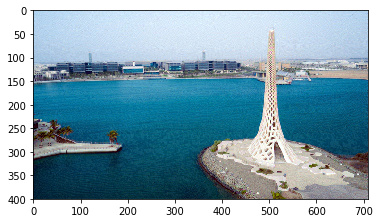

Total loss:  24135657472.0
Weighted Content loss:  5.8773040771484375
Weighted Style loss:  24135658517.479897
Time [s]:  358.90979623794556


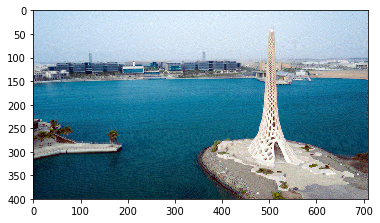

Total loss:  14930933760.0
Weighted Content loss:  6.199304103851318
Weighted Style loss:  14930933713.912964
Time [s]:  538.4870352745056


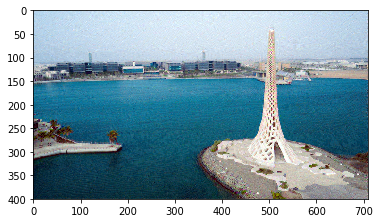

Total loss:  10033445888.0
Weighted Content loss:  6.407284736633301
Weighted Style loss:  10033445432.782173
Time [s]:  718.1343445777893


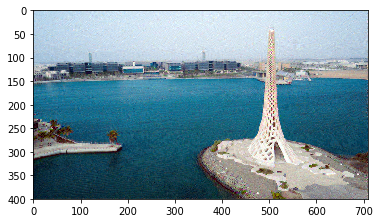

Total loss:  7476680192.0
Weighted Content loss:  6.544754981994629
Weighted Style loss:  7476679980.754852
Time [s]:  897.6193172931671


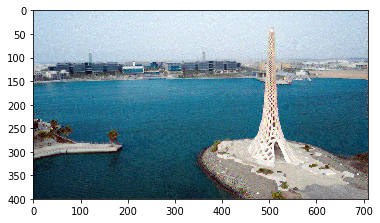

Total loss:  6113156096.0
Weighted Content loss:  6.649017333984375
Weighted Style loss:  6113156210.631132
Time [s]:  1077.2596898078918


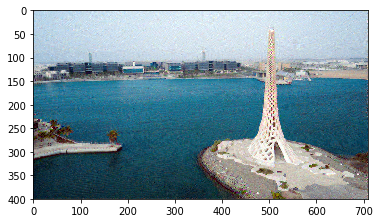

Total Time [s]:  1077.600842475891


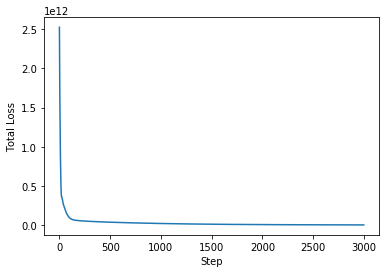

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 3000, lr = 0.003)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e3, steps = 2000, lr = 0.001 

(2000,)
Total loss:  6.840579986572266
Weighted Content loss:  3.763758420944214
Weighted Style loss:  3.0768217984586954
Time [s]:  172.60861611366272


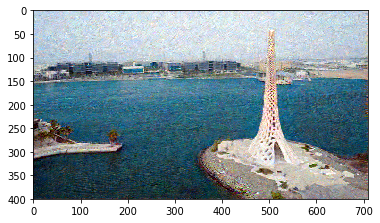

Total loss:  6.685506820678711
Weighted Content loss:  3.6347503662109375
Weighted Style loss:  3.050756175071001
Time [s]:  344.539187669754


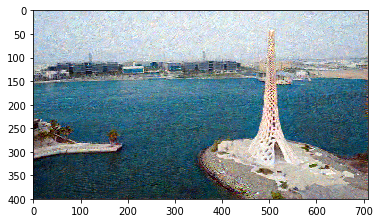

Total loss:  6.592313766479492
Weighted Content loss:  3.5692050457000732
Weighted Style loss:  3.023108933120966
Time [s]:  516.782411813736


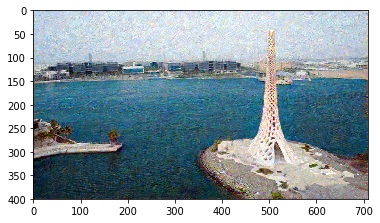

Total loss:  6.526926517486572
Weighted Content loss:  3.5234501361846924
Weighted Style loss:  3.003476420417428
Time [s]:  689.2412719726562


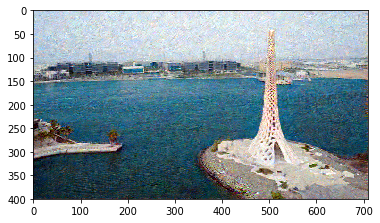

Total Time [s]:  689.577944278717


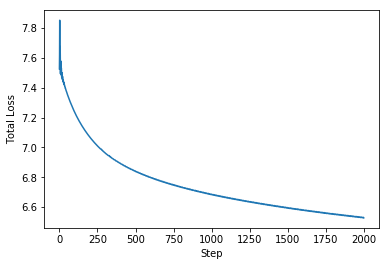

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e3, steps = 2000, lr = 0.001)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e6, steps = 2000, lr = 0.001 

(2000,)
Total loss:  2484.392822265625
Weighted Content loss:  4.69691276550293
Weighted Style loss:  2479.695715010166
Time [s]:  175.8001754283905


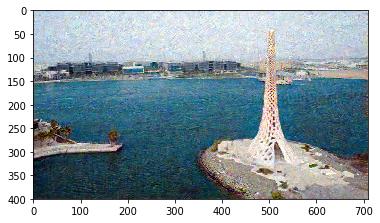

Total loss:  2389.259521484375
Weighted Content loss:  4.90986442565918
Weighted Style loss:  2384.3497037887573
Time [s]:  351.7550530433655


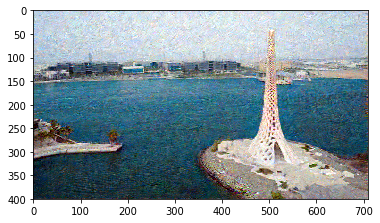

Total loss:  2332.753662109375
Weighted Content loss:  5.014067649841309
Weighted Style loss:  2327.739493921399
Time [s]:  525.9465291500092


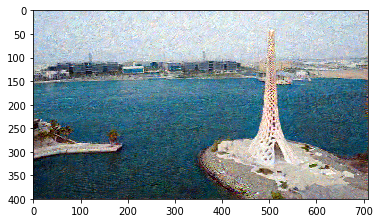

Total loss:  2295.330810546875
Weighted Content loss:  5.074884414672852
Weighted Style loss:  2290.255855768919
Time [s]:  701.2411389350891


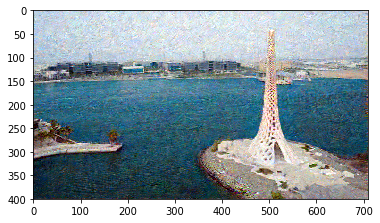

Total Time [s]:  701.5772500038147


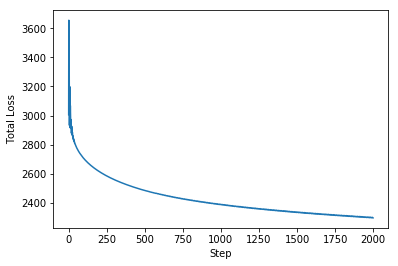

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e6, steps = 2000, lr = 0.001)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e9, steps = 2000, lr = 0.001 

(2000,)
Total loss:  2278273.0
Weighted Content loss:  5.096171855926514
Weighted Style loss:  2278268.104419112
Time [s]:  171.86489391326904


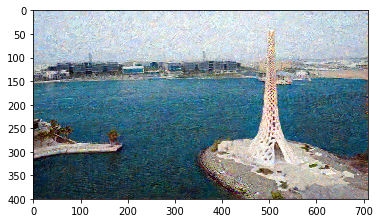

Total loss:  2260022.5
Weighted Content loss:  5.123308181762695
Weighted Style loss:  2260017.44158566
Time [s]:  344.13649129867554


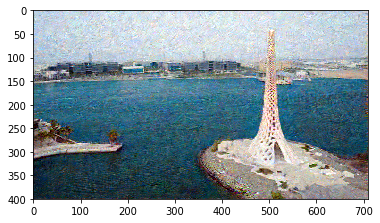

Total loss:  2239302.5
Weighted Content loss:  5.153417110443115
Weighted Style loss:  2239297.144114971
Time [s]:  516.3842175006866


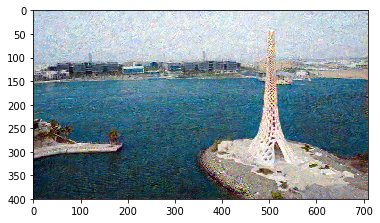

Total loss:  2219462.0
Weighted Content loss:  5.181269645690918
Weighted Style loss:  2219456.7136466503
Time [s]:  688.5747649669647


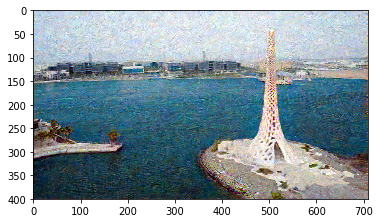

Total Time [s]:  688.8979916572571


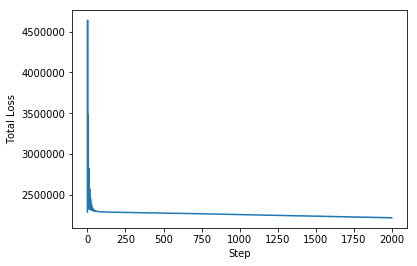

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 2000, lr = 0.001)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 2000, lr = 0.001 

(2000,)
Total loss:  2211662848.0
Weighted Content loss:  5.191782474517822
Weighted Style loss:  2211662940.6809807
Time [s]:  175.28247928619385


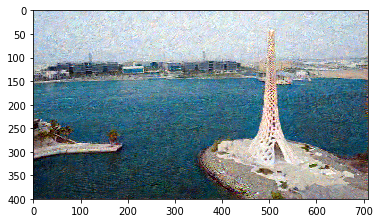

Total loss:  2200518912.0
Weighted Content loss:  5.205852031707764
Weighted Style loss:  2200518967.5837755
Time [s]:  350.31057476997375


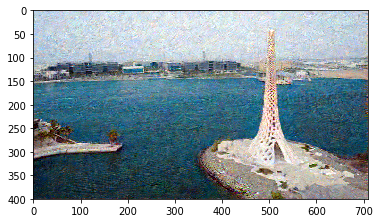

Total loss:  2187347712.0
Weighted Content loss:  5.224986553192139
Weighted Style loss:  2187347738.072276
Time [s]:  525.8122398853302


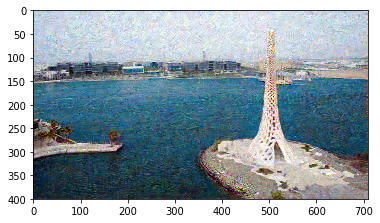

Total loss:  2176180480.0
Weighted Content loss:  5.244157314300537
Weighted Style loss:  2176180481.9107056
Time [s]:  701.453031539917


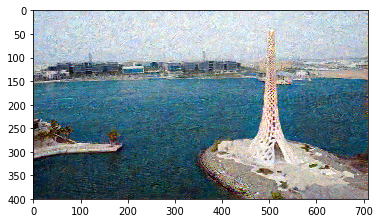

Total Time [s]:  701.789532661438


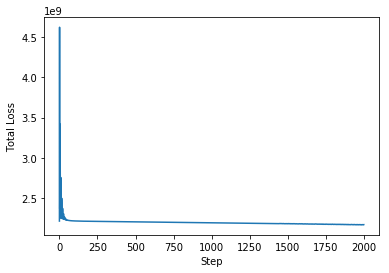

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 2000, lr = 0.001)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e3, steps = 2000, lr = 0.1

(2000,)
Total loss:  13.265865325927734
Weighted Content loss:  5.444494724273682
Weighted Style loss:  7.821370847523212
Time [s]:  169.8901665210724


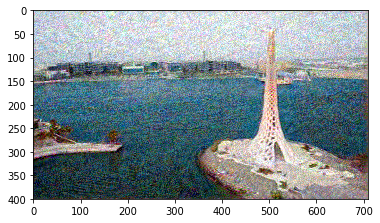

Total loss:  10.805439949035645
Weighted Content loss:  4.842276573181152
Weighted Style loss:  5.963163450360298
Time [s]:  342.1357316970825


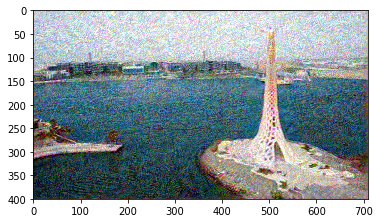

Total loss:  9.687190055847168
Weighted Content loss:  4.507116317749023
Weighted Style loss:  5.180073902010918
Time [s]:  513.8841125965118


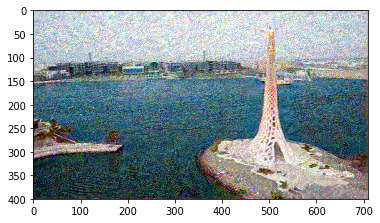

Total loss:  10.259186744689941
Weighted Content loss:  4.251550197601318
Weighted Style loss:  6.007636431604624
Time [s]:  685.5397808551788


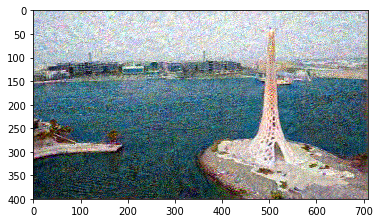

Total Time [s]:  686.0277383327484


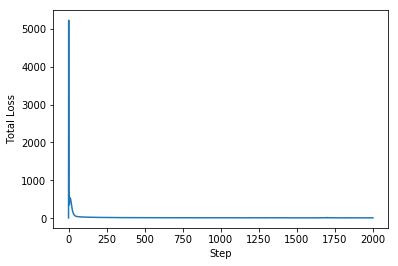

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e3, steps = 2000, lr = 0.1)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e6, steps = 2000, lr = 0.1

(2000,)
Total loss:  6778.94140625
Weighted Content loss:  8.529891967773438
Weighted Style loss:  6770.411506295204
Time [s]:  171.67313647270203


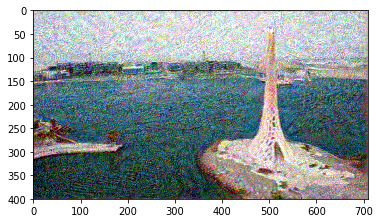

Total loss:  5139.6865234375
Weighted Content loss:  8.643000602722168
Weighted Style loss:  5131.043493747711
Time [s]:  346.411985874176


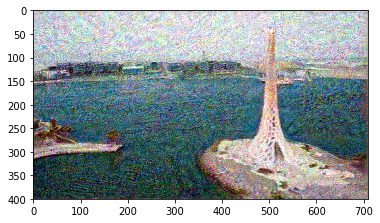

Total loss:  4124.12646484375
Weighted Content loss:  8.625337600708008
Weighted Style loss:  4115.500953048468
Time [s]:  520.536230802536


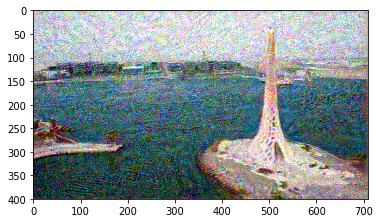

Total loss:  5196.0078125
Weighted Content loss:  8.553497314453125
Weighted Style loss:  5187.454167753458
Time [s]:  693.9404411315918


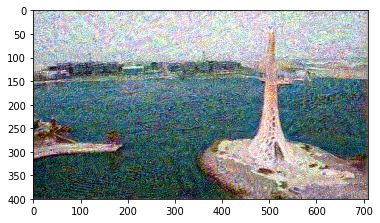

Total Time [s]:  694.2793161869049


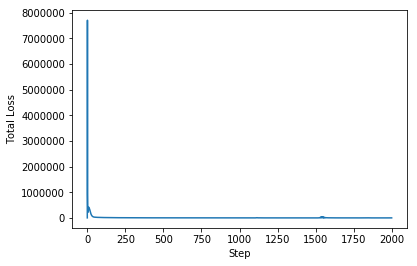

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e6, steps = 2000, lr = 0.1)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e9, steps = 1000, lr = 0.1

(1000,)
Total loss:  12896081.0
Weighted Content loss:  8.544010162353516
Weighted Style loss:  12896072.119474411
Time [s]:  170.30402660369873


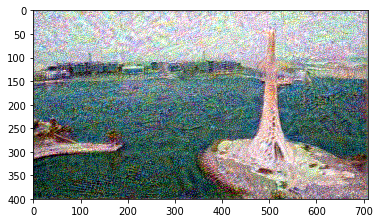

Total loss:  6206797.5
Weighted Content loss:  9.01234245300293
Weighted Style loss:  6206788.5883152485
Time [s]:  341.1126890182495


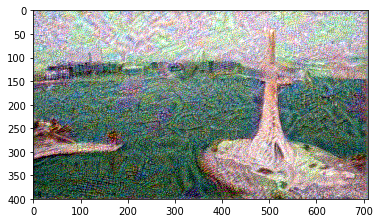

Total Time [s]:  341.46834325790405


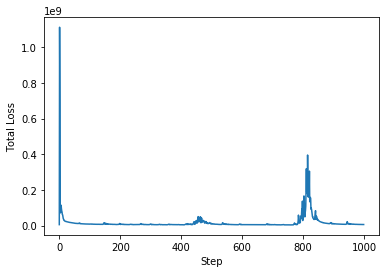

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 1000, lr = 0.1)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 1000, lr = 0.1

(1000,)
Total loss:  5850498560.0
Weighted Content loss:  9.198265075683594
Weighted Style loss:  5850498564.54134
Time [s]:  172.81007623672485


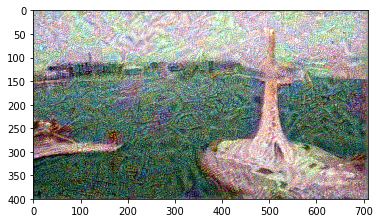

Total loss:  4379931136.0
Weighted Content loss:  9.204325675964355
Weighted Style loss:  4379931371.65904
Time [s]:  345.9921188354492


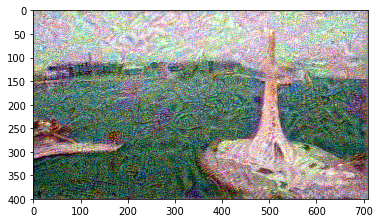

Total Time [s]:  346.3399579524994


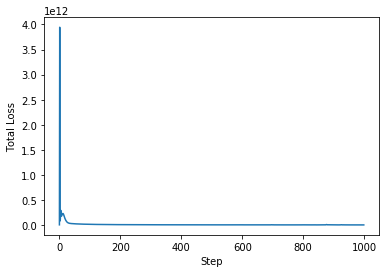

In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 1000, lr = 0.1)
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## 2nd Example

### style_weight = 1.0e3, steps = 2000, lr = 0.01 (best so far)

(2000,)
Total loss:  28.46810531616211
Weighted Content loss:  8.347027778625488
Weighted Style loss:  20.121078938245773
Time [s]:  142.86839056015015


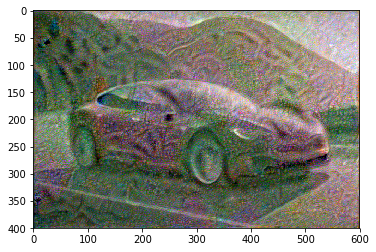

Total loss:  26.39859390258789
Weighted Content loss:  8.281744003295898
Weighted Style loss:  18.116850405931473
Time [s]:  287.8875181674957


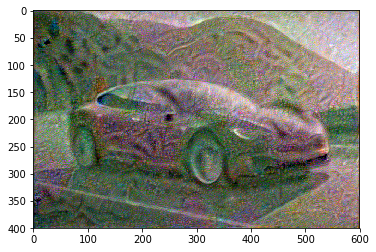

Total loss:  25.65650177001953
Weighted Content loss:  8.244973182678223
Weighted Style loss:  17.411530017852783
Time [s]:  430.4660589694977


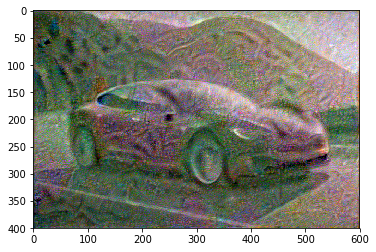

Total loss:  24.843191146850586
Weighted Content loss:  8.175657272338867
Weighted Style loss:  16.667533665895462
Time [s]:  572.0156857967377


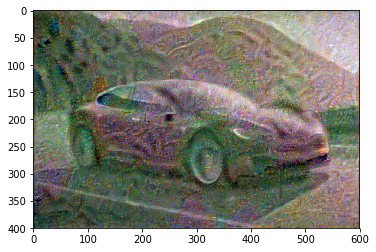

Total Time [s]:  572.3172118663788


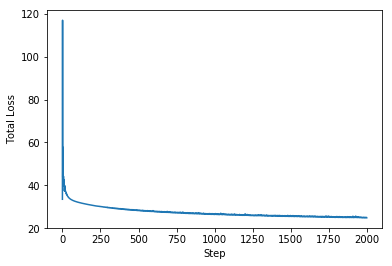

In [0]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[s_1, slc_1] = run_model(vgg, layers_vgg, target[1], content_features_vgg[1], style_grams_vgg[1], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e3, steps = 2000, lr = 0.01)
plt.plot(slc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e3, steps = 2000, lr = 0.1 (too large)

(2000,)
Total loss:  93.5834732055664
Weighted Content loss:  8.509574890136719
Weighted Style loss:  85.07389575242996
Time [s]:  143.45965933799744


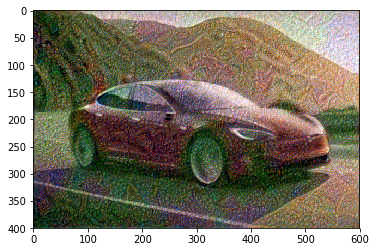

Total loss:  29.763748168945312
Weighted Content loss:  7.704248905181885
Weighted Style loss:  22.059500217437744
Time [s]:  286.2169668674469


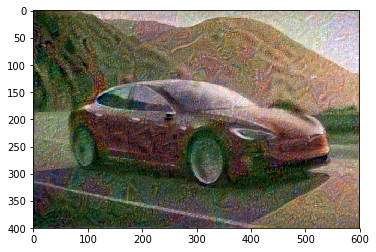

Total loss:  31.993614196777344
Weighted Content loss:  8.294032096862793
Weighted Style loss:  23.699581623077393
Time [s]:  428.9732880592346


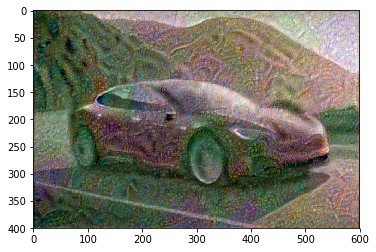

Total loss:  33.39862823486328
Weighted Content loss:  8.569334030151367
Weighted Style loss:  24.82929639518261
Time [s]:  571.6860995292664


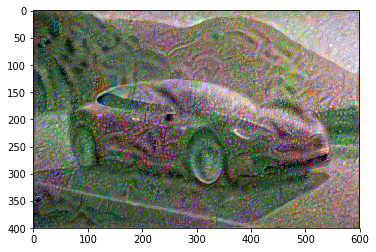

Total Time [s]:  572.0144028663635


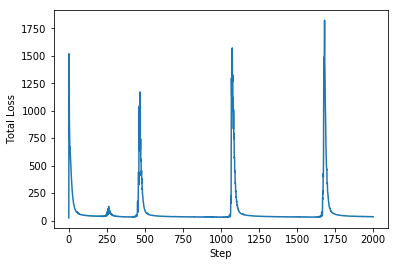

In [0]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
# lr is a little large
[s_1, slc_1] = run_model(vgg, layers_vgg, target[1], content_features_vgg[1], style_grams_vgg[1], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e3, steps = 2000, lr = 0.1)
plt.plot(slc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e9, steps = 2000, lr = 0.01
### doesn't have too much difference from the original picture

(2000,)
Total loss:  19784878.0
Weighted Content loss:  6.747801780700684
Weighted Style loss:  19784871.488809586
Time [s]:  142.46517944335938


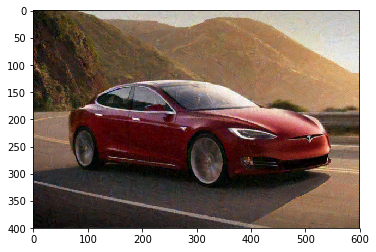

Total loss:  18006436.0
Weighted Content loss:  6.833272933959961
Weighted Style loss:  18006430.938839912
Time [s]:  285.3302230834961


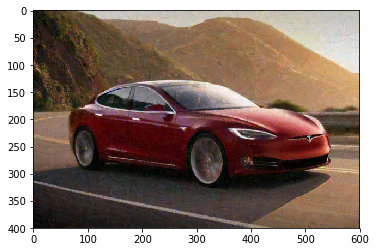

Total loss:  17202942.0
Weighted Content loss:  6.885269641876221
Weighted Style loss:  17202936.112880707
Time [s]:  428.23691964149475


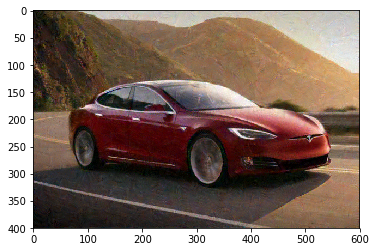

Total loss:  16758469.0
Weighted Content loss:  6.926795959472656
Weighted Style loss:  16758462.41414547
Time [s]:  571.5733954906464


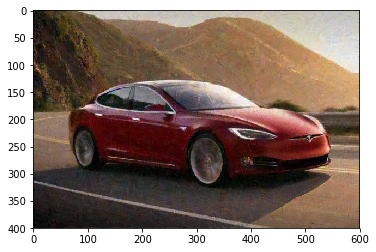

Total Time [s]:  571.904853105545


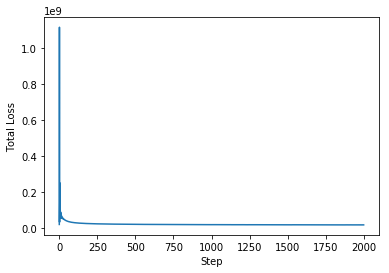

In [0]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[s_1, slc_1] = run_model(vgg, layers_vgg, target[1], content_features_vgg[1], style_grams_vgg[1], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 2000, lr = 0.01)
plt.plot(slc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e6, steps = 2000, lr = 0.01

(2000,)
Total loss:  23918.072265625
Weighted Content loss:  6.568746089935303
Weighted Style loss:  23911.504074931145
Time [s]:  143.0119960308075


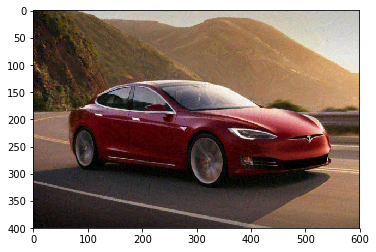

Total loss:  20729.62109375
Weighted Content loss:  6.873032569885254
Weighted Style loss:  20722.748711705208
Time [s]:  286.8930208683014


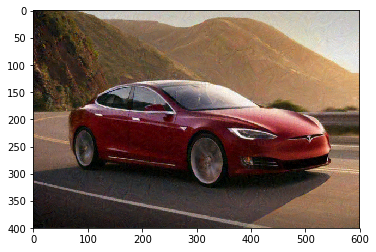

Total loss:  18709.6953125
Weighted Content loss:  6.9450788497924805
Weighted Style loss:  18702.74916291237
Time [s]:  431.06374192237854


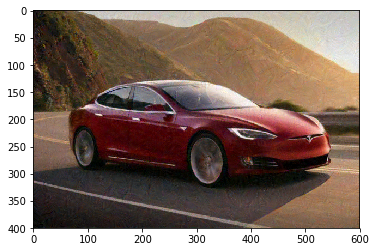

Total loss:  17990.236328125
Weighted Content loss:  7.001993656158447
Weighted Style loss:  17983.23355615139
Time [s]:  575.4504327774048


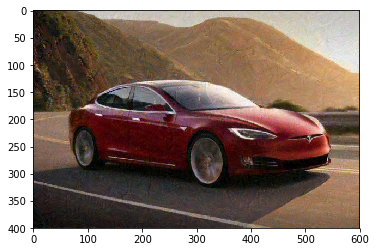

Total Time [s]:  575.780933380127


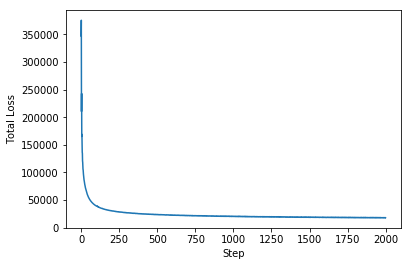

In [0]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[s_1, slc_1] = run_model(vgg, layers_vgg, target[1], content_features_vgg[1], style_grams_vgg[1], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e6, steps = 2000, lr = 0.01)
plt.plot(slc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## 3rd Example

### style_weight = 1.0e3, steps = 2000, lr = 0.01

(2000,)
Total loss:  21.080581665039062
Weighted Content loss:  5.16826057434082
Weighted Style loss:  15.912322327494621
Time [s]:  121.1120343208313


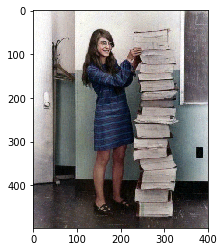

Total loss:  18.471473693847656
Weighted Content loss:  5.190708160400391
Weighted Style loss:  13.280765153467655
Time [s]:  242.59770393371582


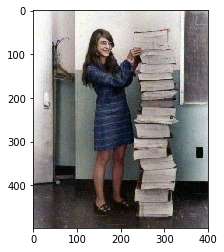

Total loss:  17.30695915222168
Weighted Content loss:  5.171848297119141
Weighted Style loss:  12.135110795497894
Time [s]:  363.44278025627136


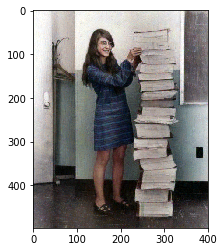

Total loss:  16.372272491455078
Weighted Content loss:  5.156366348266602
Weighted Style loss:  11.215905658900738
Time [s]:  484.20533776283264


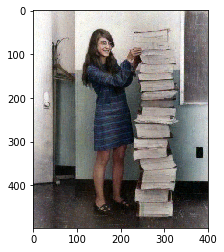

Total Time [s]:  484.47083282470703


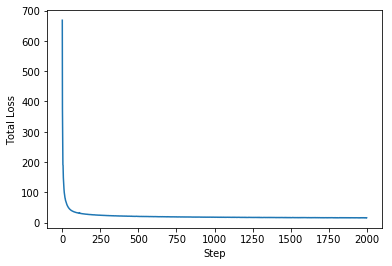

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e3, steps = 2000, lr = 0.01)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e6, steps = 2000, lr = 0.01

(2000,)
Total loss:  8498.80078125
Weighted Content loss:  9.099587440490723
Weighted Style loss:  8489.700965583324
Time [s]:  130.04855298995972


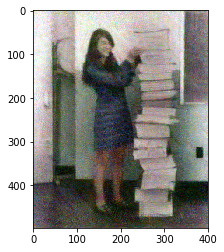

Total loss:  8303.509765625
Weighted Content loss:  9.097748756408691
Weighted Style loss:  8294.411934912205
Time [s]:  260.4267318248749


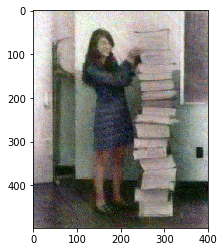

Total loss:  8328.462890625
Weighted Content loss:  9.095940589904785
Weighted Style loss:  8319.367654621601
Time [s]:  390.19629168510437


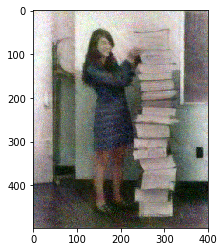

Total loss:  7956.53173828125
Weighted Content loss:  9.132545471191406
Weighted Style loss:  7947.399280965328
Time [s]:  520.1683483123779


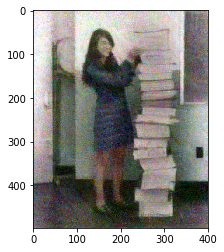

Total Time [s]:  520.4289050102234


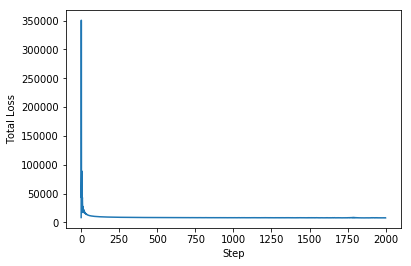

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e6, steps = 2000, lr = 0.01)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e9, steps = 2000, lr = 0.1

(2000,)
Total loss:  23091358.0
Weighted Content loss:  8.989828109741211
Weighted Style loss:  23091349.750757217
Time [s]:  119.26737475395203


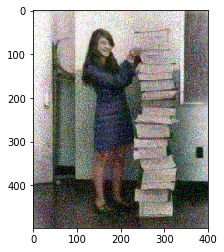

Total loss:  15800779.0
Weighted Content loss:  9.100770950317383
Weighted Style loss:  15800770.372152328
Time [s]:  238.98836278915405


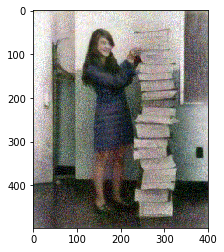

Total loss:  12725639.0
Weighted Content loss:  9.191864013671875
Weighted Style loss:  12725629.843771458
Time [s]:  358.5901951789856


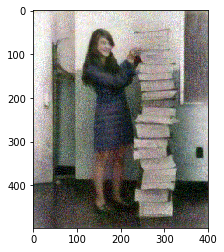

Total loss:  14430484.0
Weighted Content loss:  9.228428840637207
Weighted Style loss:  14430475.421249866
Time [s]:  479.32046031951904


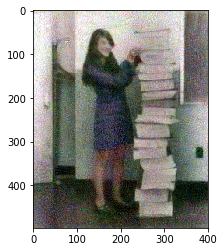

Total Time [s]:  479.5819456577301


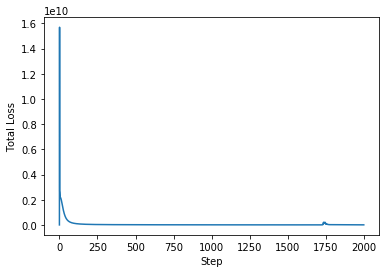

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 2000, lr = 0.1)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 500, lr = 0.1

(500,)
Total loss:  18468780032.0
Weighted Content loss:  8.942943572998047
Weighted Style loss:  18468780443.07232
Time [s]:  129.26464796066284


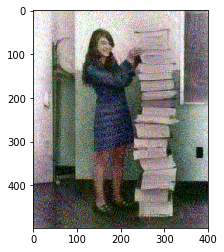

Total Time [s]:  129.55980134010315


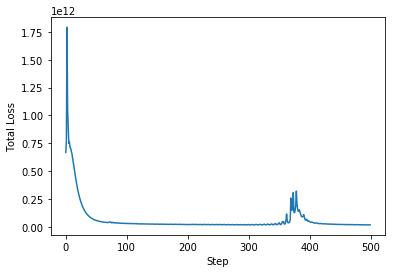

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 500, lr = 0.1)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 500, lr = 0.01

(500,)
Total loss:  11608844288.0
Weighted Content loss:  9.008987426757812
Weighted Style loss:  11608844622.969627
Time [s]:  129.75977683067322


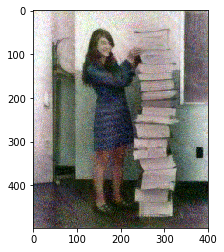

Total Time [s]:  130.00510549545288


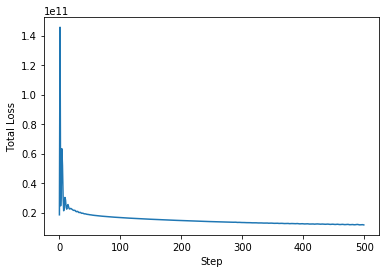

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 500, lr = 0.01)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 500, lr = 0.001

(500,)
Total loss:  10422519808.0
Weighted Content loss:  9.031712532043457
Weighted Style loss:  10422520339.488983
Time [s]:  129.5822355747223


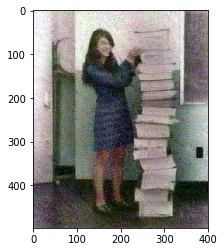

Total Time [s]:  129.83061575889587


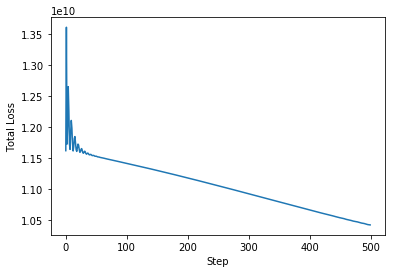

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 500, lr = 0.001)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 1000, lr = 0.001

(1000,)
Total loss:  9983984640.0
Weighted Content loss:  9.036819458007812
Weighted Style loss:  9983984753.489494
Time [s]:  130.1006851196289


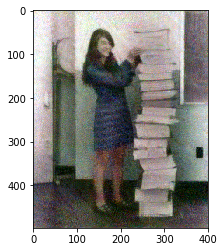

Total loss:  9448726528.0
Weighted Content loss:  9.049273490905762
Weighted Style loss:  9448726661.503315
Time [s]:  259.8426513671875


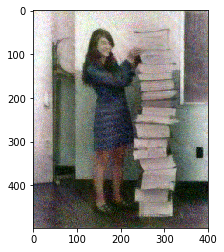

Total Time [s]:  260.1045467853546


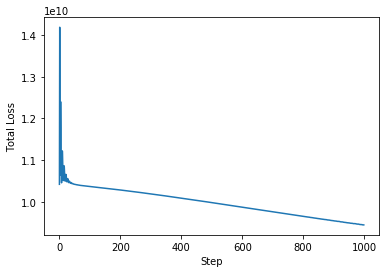

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 1000, lr = 0.001)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 2000, lr = 0.001 (best so far)

(2000,)
Total loss:  9258387456.0
Weighted Content loss:  9.057426452636719
Weighted Style loss:  9258387610.316277
Time [s]:  129.92768168449402


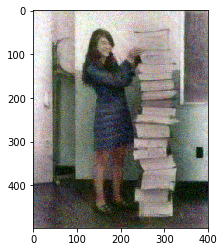

Total loss:  8986719232.0
Weighted Content loss:  9.06491756439209
Weighted Style loss:  8986718952.655792
Time [s]:  259.9635806083679


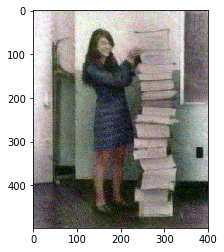

Total loss:  8723314688.0
Weighted Content loss:  9.075840950012207
Weighted Style loss:  8723314851.522446
Time [s]:  389.5369780063629


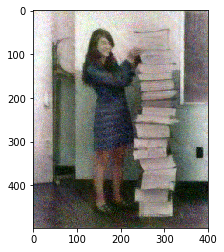

Total loss:  8516326400.0
Weighted Content loss:  9.081705093383789
Weighted Style loss:  8516326546.669006
Time [s]:  519.2783143520355


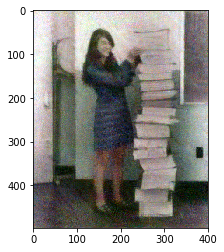

Total Time [s]:  519.5325798988342


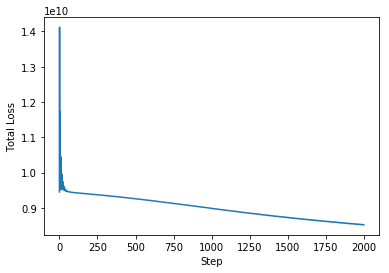

In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 2000, lr = 0.001)
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## 4th Example

### style_weight = 1.0e12, steps = 2000, lr = 0.01 

(2000,)
Total loss:  889415073792.0
Weighted Content loss:  23.439931869506836
Weighted Style loss:  889415085315.7043
Time [s]:  135.27058672904968


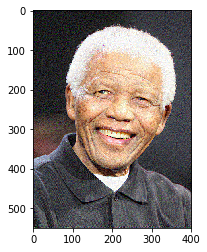

Total loss:  573566484480.0
Weighted Content loss:  24.368722915649414
Weighted Style loss:  573566496372.2229
Time [s]:  271.0873107910156


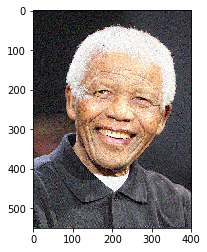

Total loss:  453625806848.0
Weighted Content loss:  24.572954177856445
Weighted Style loss:  453625798225.40283
Time [s]:  407.0267870426178


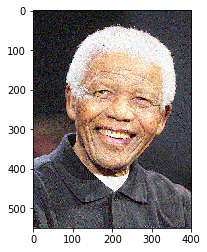

Total loss:  383073583104.0
Weighted Content loss:  24.657665252685547
Weighted Style loss:  383073598146.4386
Time [s]:  542.2199263572693


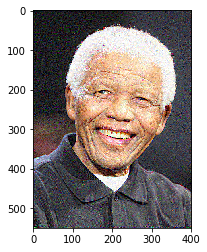

Total Time [s]:  542.5051717758179


In [0]:
# TODO Task 4: Style Transfer for content[3] and style[3] stored in target[3]
[s_3, slc_3] = run_model(vgg, layers_vgg, target[3], content_features_vgg[3], style_grams_vgg[3], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 2000, lr = 0.01)

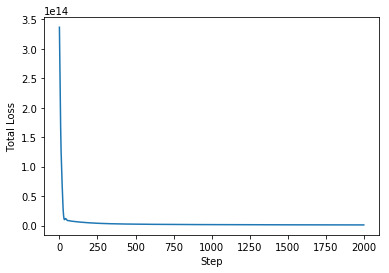

In [0]:
plt.plot(slc_3)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

### style_weight = 1.0e12, steps = 2000, lr = 0.1

(2000,)
Total loss:  987433402368.0
Weighted Content loss:  25.849163055419922
Weighted Style loss:  987433433532.7148
Time [s]:  141.86465764045715


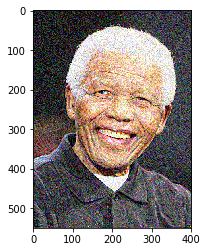

Total loss:  774662520832.0
Weighted Content loss:  26.071632385253906
Weighted Style loss:  774662494659.4238
Time [s]:  284.0336353778839


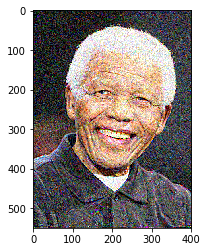

Total loss:  690560827392.0
Weighted Content loss:  26.136690139770508
Weighted Style loss:  690560817718.5059
Time [s]:  426.1046051979065


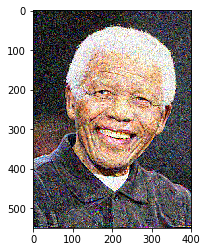

Total loss:  671140282368.0
Weighted Content loss:  26.344364166259766
Weighted Style loss:  671140313148.4985
Time [s]:  567.9895582199097


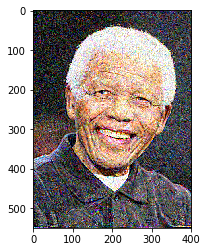

Total Time [s]:  568.2346768379211


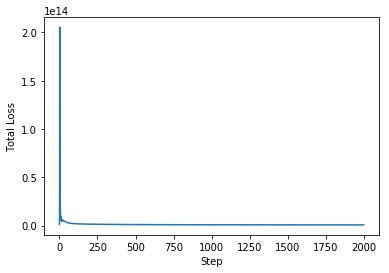

In [0]:
# TODO Task 4: Style Transfer for content[3] and style[3] stored in target[3]
[s_3, slc_3] = run_model(vgg, layers_vgg, target[3], content_features_vgg[3], style_grams_vgg[3], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 2000, lr = 0.1)
plt.plot(slc_3)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## Store final target images

In [0]:
def result_to_hd(image, filePath):
    image = im_convert(image)

    formatted = (image * 255 / np.max(image)).astype('uint8')
    pil_image = Image.fromarray(formatted, 'RGB')
    pil_image.save(filePath, "JPEG")

In [0]:
# Save results to hard disc
result_to_hd(s_0, "s0.jpg")
result_to_hd(s_1, "s1.jpg")
result_to_hd(s_2, "s2.jpg")
result_to_hd(s_3, "s3.jpg")

In [0]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 2, figsize=(20, 20))

axs[0, 0].set_title('Reference Solutions', fontsize=20)
axs[0, 1].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(ref_vgg[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

## ResNet-18

Although the authors suggested to use the VGG net for feature extraction, we want to experiment with a different net in the next step and choose the ResNet-18 network for this purpose.

## Task 5: Apply changes to ResNet-18 (5 points) 

In [0]:
# cx: what does the ResNet-18 look like?
# get the resnet18 model
resnet = models.resnet18(pretrained=True).to(device)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/checkpoints/resnet18-5c106cde.pth
100%|██████████| 46827520/46827520 [00:00<00:00, 76321758.04it/s]


In [0]:
# get the resnet18 model
resnet = models.resnet18(pretrained=True).to(device)

# TODO Task 5: Remove last few layers (avgpool and fc) from resnet by substituting them with 'identity' (e.g. empty Sequential) layers
# since they are not needed and are also incompatible to the size of our input images


resnet._modules['avgpool'] = nn.Sequential()
resnet._modules['fc'] = nn.Sequential()

# freeze all resnet parameters since we're only optimizing the target image
for param in resnet.parameters():
    param.requires_grad_(False)

In [0]:
# print out ResNet-18 structure so you can see the names of various layers
# print(resnet)

In [0]:
# definition of all the layers needed from resnet-18
layers_resnet = { 'conv1': 'conv1',
                 'layer1': 'conv2_x',
                 'layer2': 'conv3_x',
                 'layer3': 'conv4_x',
                 'layer4': 'conv5_x'}

In [0]:
# get content and style features only once before training
content_features_resnet = [get_features(c, resnet, layers_resnet) for c in content]
style_features_resnet = [get_features(s, resnet, layers_resnet) for s in style]

# calculate the gram matrices for each layer of our style representation
style_grams_resnet = [{layer: gram_matrix(s[layer]) for layer in s} for s in style_features_resnet]

In [0]:
# 'conv1': 1., 
# cx: conv1 is the content layer, I should replace the vgg style weights with the resNet when I use resNet instead of vgg
style_weights_resnet = {'conv2_x': 0.8,
                        'conv3_x': 0.5,
                        'conv4_x': 0.3,
                        'conv5_x': 0.1}

## Task 6: Styler Transfer using ResNet-18 (12 points - 4 examples, 3 points each)

Experiment with different weights for style (1.0e3, 1.0e6, 1.0e9, 1.0e12), different numbers of steps (e.g. 2000, 5000, 10000) and different learning rates (e.g. 0.1, 0.01, 0.001) to find a set of parameters with which you can create a stylized image that looks similar (or preferably better) to the provided reference solution.

In [0]:
# Target Image = Content Image (Reload original images)
target = [c.clone().requires_grad_(True).to(device) for c in content]

## ResNet 1st example

(5000,)
Total loss:  405181216.0
Weighted Content loss:  0.05714462697505951
Weighted Style loss:  405181228.41604054
Time [s]:  30.75748562812805


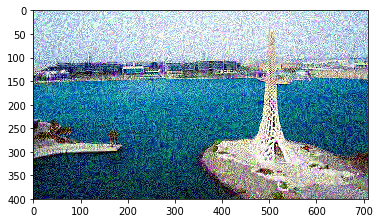

Total loss:  350175296.0
Weighted Content loss:  0.05765438452363014
Weighted Style loss:  350175308.99494886
Time [s]:  64.51918840408325


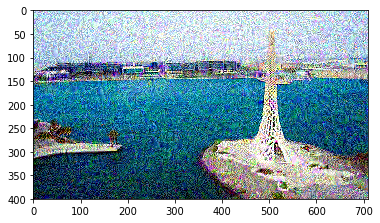

Total loss:  319984608.0
Weighted Content loss:  0.057842545211315155
Weighted Style loss:  319984625.0936389
Time [s]:  97.98957133293152


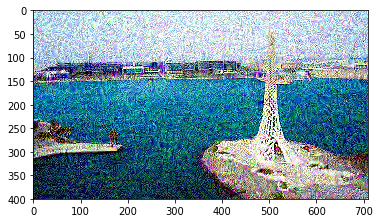

Total loss:  332024864.0
Weighted Content loss:  0.058134134858846664
Weighted Style loss:  332024879.75358963
Time [s]:  130.87158036231995


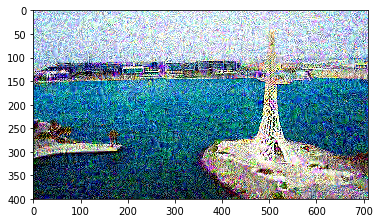

Total loss:  293740864.0
Weighted Content loss:  0.05823324993252754
Weighted Style loss:  293740857.1597189
Time [s]:  163.58225178718567


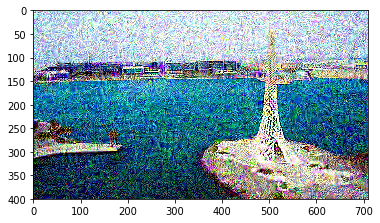

Total loss:  288141696.0
Weighted Content loss:  0.05826681852340698
Weighted Style loss:  288141687.6334697
Time [s]:  196.54139709472656


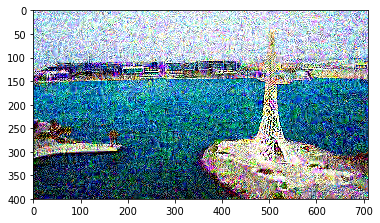

Total loss:  281043456.0
Weighted Content loss:  0.05839632824063301
Weighted Style loss:  281043467.11188555
Time [s]:  229.47456002235413


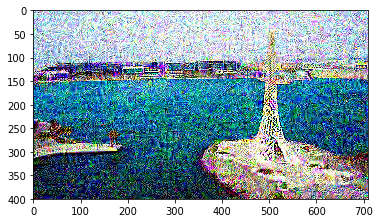

Total loss:  282783968.0
Weighted Content loss:  0.058498453348875046
Weighted Style loss:  282783963.4846896
Time [s]:  262.19158697128296


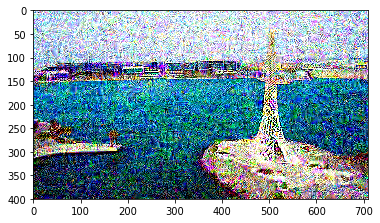

Total loss:  269702496.0
Weighted Content loss:  0.05850236117839813
Weighted Style loss:  269702490.18631876
Time [s]:  295.0752193927765


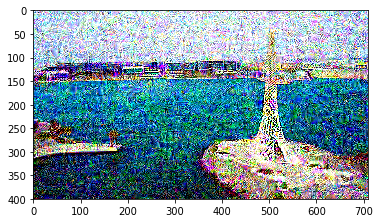

Total loss:  260127072.0
Weighted Content loss:  0.05860230326652527
Weighted Style loss:  260127068.03157926
Time [s]:  327.99927043914795


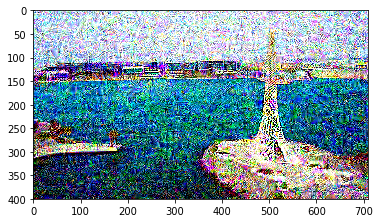

Total Time [s]:  328.3430845737457


In [0]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[res_0, reslc_0] = run_model(resnet, layers_resnet, target[0], content_features_resnet[0], style_grams_resnet[0], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.1)

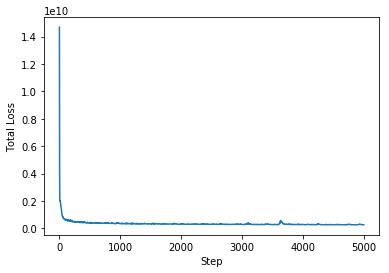

In [0]:
plt.plot(reslc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## ResNet 2nd Example

(5000,)
Total loss:  549763328.0
Weighted Content loss:  0.05460740625858307
Weighted Style loss:  549763324.6704936
Time [s]:  27.03113579750061


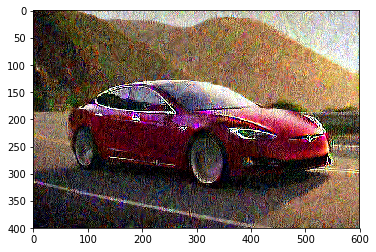

Total loss:  442853280.0
Weighted Content loss:  0.05460873991250992
Weighted Style loss:  442853284.76689756
Time [s]:  54.22526407241821


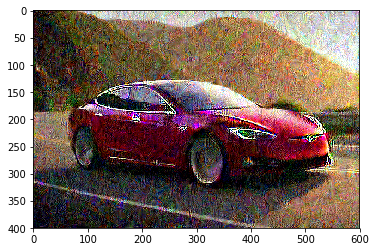

Total loss:  421494752.0
Weighted Content loss:  0.05482010543346405
Weighted Style loss:  421494740.29429257
Time [s]:  83.16892719268799


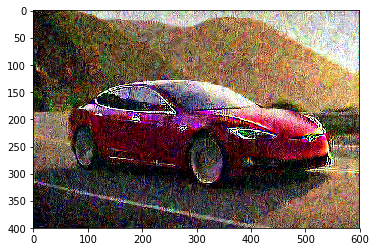

Total loss:  423174336.0
Weighted Content loss:  0.05506078898906708
Weighted Style loss:  423174322.3499507
Time [s]:  112.03933262825012


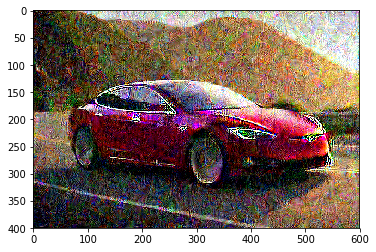

Total loss:  387515968.0
Weighted Content loss:  0.05519567430019379
Weighted Style loss:  387515960.02839506
Time [s]:  141.01311707496643


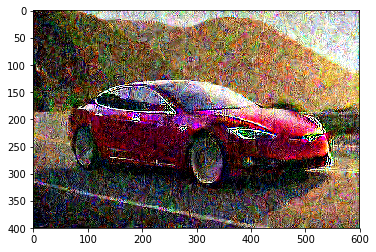

Total loss:  383322848.0
Weighted Content loss:  0.055239006876945496
Weighted Style loss:  383322854.7591716
Time [s]:  169.9822542667389


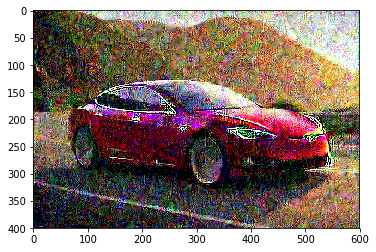

Total loss:  372945152.0
Weighted Content loss:  0.055306192487478256
Weighted Style loss:  372945156.4140618
Time [s]:  198.82058262825012


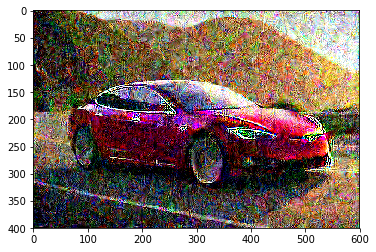

Total loss:  355090976.0
Weighted Content loss:  0.055326975882053375
Weighted Style loss:  355090975.06292164
Time [s]:  227.77864265441895


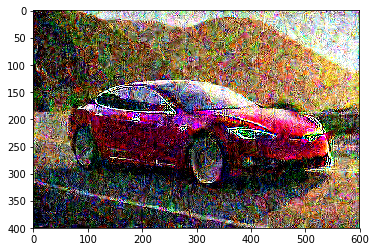

Total loss:  360471168.0
Weighted Content loss:  0.05541470646858215
Weighted Style loss:  360471167.36881435
Time [s]:  256.83161783218384


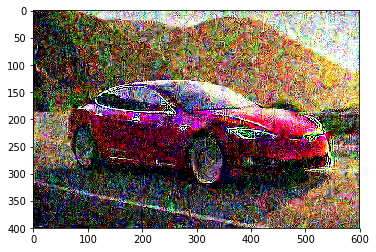

Total loss:  349124256.0
Weighted Content loss:  0.05542605370283127
Weighted Style loss:  349124253.2618344
Time [s]:  286.6526629924774


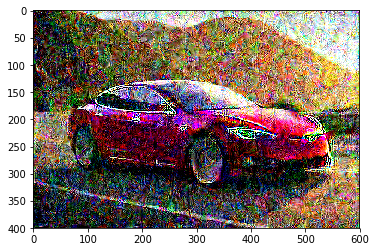

Total Time [s]:  287.01540780067444


In [0]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[res_1, reslc_1] = run_model(resnet, layers_resnet, target[1], content_features_resnet[1], style_grams_resnet[1], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.1)

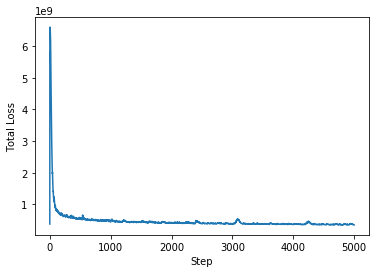

In [0]:
plt.plot(reslc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## ResNet 3rd Example

(5000,)
Total loss:  0.4250769019126892
Weighted Content loss:  0.054795168340206146
Weighted Style loss:  0.3702817193698138
Time [s]:  22.847288846969604


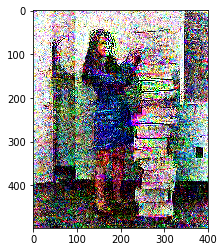

Total loss:  0.4236264228820801
Weighted Content loss:  0.054514508694410324
Weighted Style loss:  0.36911192000843585
Time [s]:  45.92593050003052


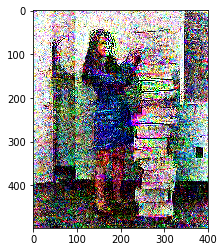

Total loss:  0.42221787571907043
Weighted Content loss:  0.054301775991916656
Weighted Style loss:  0.36791610182262957
Time [s]:  69.06850814819336


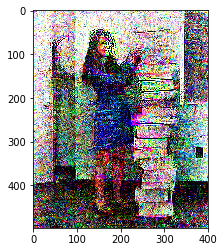

Total loss:  0.42091548442840576
Weighted Content loss:  0.054130919277668
Weighted Style loss:  0.3667845739983022
Time [s]:  92.23981785774231


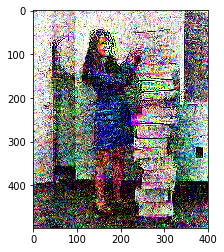

Total loss:  0.41976773738861084
Weighted Content loss:  0.053994759917259216
Weighted Style loss:  0.36577298305928707
Time [s]:  115.47475981712341


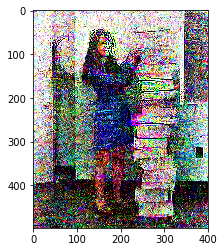

Total loss:  0.4185950756072998
Weighted Content loss:  0.05386866629123688
Weighted Style loss:  0.36472638021223247
Time [s]:  138.68290662765503


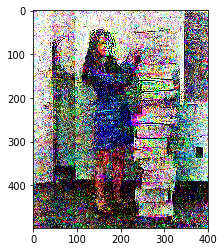

Total loss:  0.41755181550979614
Weighted Content loss:  0.05375475808978081
Weighted Style loss:  0.3637970658019185
Time [s]:  161.90701293945312


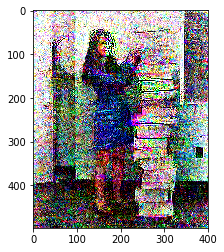

Total loss:  0.41648611426353455
Weighted Content loss:  0.05365704745054245
Weighted Style loss:  0.36282907240092754
Time [s]:  184.84813022613525


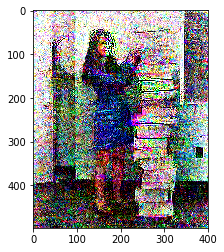

Total loss:  0.41555941104888916
Weighted Content loss:  0.0535711944103241
Weighted Style loss:  0.3619882045313716
Time [s]:  209.4567949771881


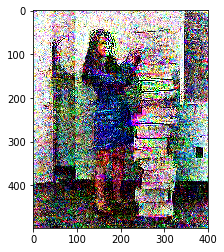

Total loss:  0.4147041440010071
Weighted Content loss:  0.053489550948143005
Weighted Style loss:  0.36121459561400115
Time [s]:  234.00654244422913


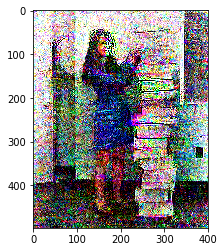

Total Time [s]:  234.27095317840576


In [0]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[res_2, reslc_2] = run_model(resnet, layers_resnet, target[2], content_features_resnet[2], style_grams_resnet[2], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e3, steps = 5000, lr = 0.001)

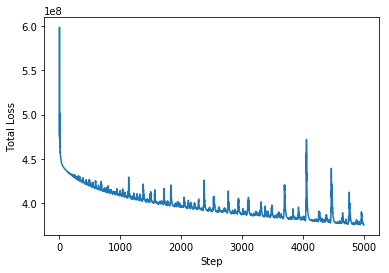

In [0]:
plt.plot(reslc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## ResNet 4th Example

(5000,)
Total loss:  448784640.0
Weighted Content loss:  0.04871199652552605
Weighted Style loss:  448784645.4139799
Time [s]:  25.899780988693237


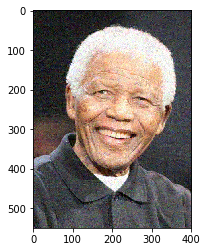

Total loss:  439613600.0
Weighted Content loss:  0.04908827319741249
Weighted Style loss:  439613591.87960625
Time [s]:  50.46442437171936


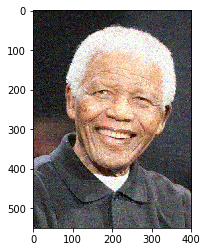

Total loss:  380180864.0
Weighted Content loss:  0.049407247453927994
Weighted Style loss:  380180863.43072355
Time [s]:  74.96498441696167


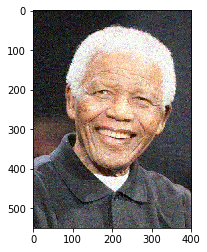

Total loss:  373356704.0
Weighted Content loss:  0.04958534240722656
Weighted Style loss:  373356713.68055046
Time [s]:  99.7449562549591


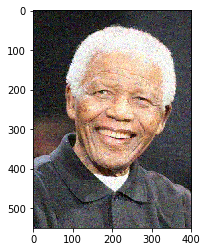

Total loss:  370055232.0
Weighted Content loss:  0.0498015470802784
Weighted Style loss:  370055233.3611995
Time [s]:  124.31559467315674


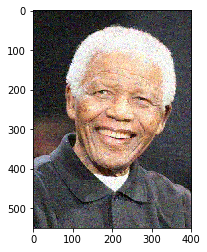

Total loss:  360446720.0
Weighted Content loss:  0.04988417401909828
Weighted Style loss:  360446720.1512307
Time [s]:  148.95135927200317


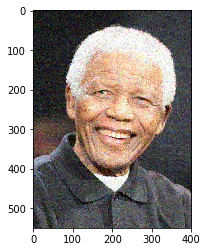

Total loss:  385151968.0
Weighted Content loss:  0.05005650967359543
Weighted Style loss:  385151972.2957164
Time [s]:  173.58058762550354


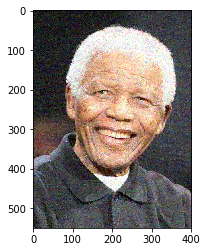

Total loss:  333014848.0
Weighted Content loss:  0.05018465965986252
Weighted Style loss:  333014846.5465754
Time [s]:  198.1216688156128


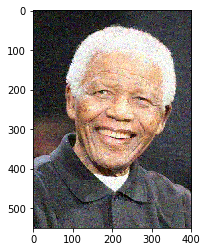

Total loss:  327542208.0
Weighted Content loss:  0.05029787868261337
Weighted Style loss:  327542220.47515213
Time [s]:  224.08869576454163


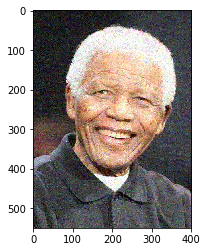

Total loss:  326171264.0
Weighted Content loss:  0.05038774013519287
Weighted Style loss:  326171255.43765724
Time [s]:  250.0473506450653


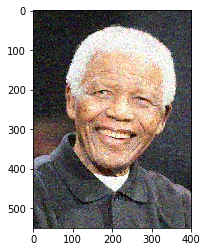

Total Time [s]:  250.32133841514587


In [0]:
# TODO Task 4: Style Transfer for content[3] and style[3] stored in target[3]
[res_3, reslc_3]  = run_model(resnet, layers_resnet, target[3], content_features_resnet[3], style_grams_resnet[3], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.01)

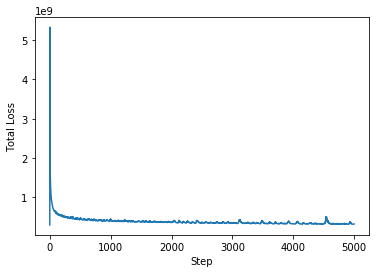

In [0]:
plt.plot(reslc_3)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

## ResNet store the traget images

In [0]:
# Save results to hard disc
result_to_hd(res_0, "res0_reference.jpg")
result_to_hd(res_1, "res1_reference.jpg")
result_to_hd(res_2, "res2_reference.jpg")
result_to_hd(res_3, "res3_reference.jpg")

In [0]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 2, figsize=(20, 20))

axs[0, 0].set_title('Reference Solutions', fontsize=20)
axs[0, 1].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(ref_res[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

## Task 6.1: Conclusion
What is the difference between the style transfer results when using VGG or ResNet? Add a short conclusion to your final report.

# Deep Correlations for Texture synthesis [2]

The paper [2] presents a texture synthesis technique that builds upon convolutional neural networks and extracted statistics of pre-trained deep features. The main contribution is the introduction of *deep correlation matrices* that allow the synthesis of textures that not only resemble local but also global structure of an example image.

## Task 7: VGG Layer Replacement (5 points)

The authors of [2] suggest to replace all MaxPool layers with Averaging layers for better results. This should be done in the cell below.

In [0]:
# Replace MaxPool Layers in VGG19 network with average pooling layers

# TODO Task 7: Identify maxpool layer indices
maxpool_idx = [4, 9, 18, 27, 36]

for i in maxpool_idx:
    # TODO Task 7: Replace maxpool layer with averaging layer (kernel_size = 2, stride = 2)
    vgg[i] = nn.AvgPool2d(kernel_size = 2, stride=2)

In [0]:
# Define the layers from which the features are extracted

layers_deepcorr = {'0': 'conv1',
                   '4': 'pool1',
                   '9': 'pool2', 
                  '18': 'pool3', 
                  '27': 'pool4'}  ## content representation

## Task 8: Implement the computation of the deep correlation matrices $R^{l,n}_{i,j}$ for a given tensor representing layer $l$ as decribed in [2] (10 points)

Note that the computation of $R^{l,n}_{i,j}$ requires a convolution (or more correctly, a cross-correlation) of each feature map with itself. Instead of trying to implement this convolution using nested `for` loops, use the `nn.Conv2d` module for performance reasons. Do not forget to use appropriate zero-padding that allows an output size equal to `output_size` and to set `bias=False`. Further do not forget to compute appropriate weights $w_{i,j}$.

In [0]:
# import torch.nn.functional as F
# def deep_corr_matrix_stack(tensor, output_size = None):
#     """ Calculate the set of Deep Correlation Matrices for a given tensor as described in [2]
#     """
#     _, depth, height, width = tensor.shape
#     wi_1 = torch.FloatTensor.abs_(torch.arange(-height,-height//2+1))
#     wi_2 = torch.arange(height//2,height)
#     wi = torch.cat((wi_2, wi_1), 0)
#     wj_1 = torch.FloatTensor.abs_(torch.arange(-width,-width//2+1))
#     wj_2 = torch.arange(width//2,width)
#     wj = torch.cat((wj_2, wj_1), 0)
#     # transpose wi into a (Q+1)x1 vector
#     wi = wi.reshape(len(wi),1)
#     wj = wj.reshape(1,len(wj))
# #     print(wi.shape)
# #     print(wj.shape)
#     w = torch.mm(wi,wj) # w is a (Q+1)x(Wx1) matrix
# #     print(w.type()) # w is a long type tensor, should be converted to float type
# #     w = 1/w
    
#     w = torch.tensor(1/w.numpy(),dtype=torch.float)
# #     print(w)
#     # TODO Task 8: implement the computation of the deep correlation matrices
#     # cx: tensor should be a set of feature maps
    
#     deep_corr = torch.tensor(())  # initialize an empty tensor object
#     for channel in tensor[0]:
#       padded_channel = F.pad(channel, pad=(width//2,width//2,height//2,height//2), mode='constant', value=0) # for arguments: right, left, upper, below
#       padded_channel = torch.unsqueeze(padded_channel,0)
#       padded_channel = torch.unsqueeze(padded_channel,0)
#       weights = torch.unsqueeze(channel, 0)
#       weights = torch.unsqueeze(weights, 0)
# #       print(channel.type())  cuda.TensorFloat
#       # padding
# #       weights = channel
# #     tensor = torch.reshape(tensor, (1,1,Q,W)) # vectorized every feature map
# #     weights = tensor # as the kernel of conv2D
#     # i [-depth/2, depth/2] vertically shifts i pixels; j [-(height*width)/2, (height*width)/2] horizontally shifts j pixels
#     # padding, tensor = torch.randn(4, 16)     # seq of variable length
#     # print(F.pad(tensor, pad=(1,3,2, 2), mode='constant', value=0))
# #     print(type(Q//2))
# #     print(int(Q//2))
# #     print(W)
# #       print(weights.shape)
# #       print(padded_channel.shape)
# #       padded_channel.unsqueeze(0)
# #       print(padded_channel.shape)
# #       conv = torch.nn.Conv2d(1, 1, kernel_size=height, padding=0, bias=False) # input and output channels are both equal to 1
#       d_corr = F.conv2d(padded_channel, weights).to(device)
# #       print(padded_channel.type())
# #       print(weights.type())
#       d_corr = w * d_corr.cpu()
# #       print(w.type())
# #       conv.weight = nn.Parameter(weights,requires_grad=False)
# #       d_corr = w * conv(padded_channel)
#       # cantatenate
# #       d_corr = d_corr[None, :, :] # add one more dimension
#       deep_corr = torch.cat((deep_corr, d_corr), 0)
# #     deep_corr = conv(tensor).reshape(Q+1, W+1) 
# #     print(deep_corr.shape)
# #     deep_corr size is (Q+1) by (W+1) why?
#     # times 
   
# #     print(w.type())
# #     deep_corr = w * deep_corr
# #     print(deep_corr.shape)
#     return deep_corr

In [0]:
import torch.nn.functional as F
# output_size should be a torch.Size object
def deep_corr_matrix_stack(tensor, output_size = None):
    """ Calculate the set of Deep Correlation Matrices for a given tensor as described in [2]
    """
    _, depth, height, width = tensor.shape
    wi_1 = torch.FloatTensor.abs_(torch.arange(-height,-height//2+1, dtype=torch.float))
    wi_2 = torch.arange(height//2,height, dtype=torch.float)
    wi = torch.cat((wi_2, wi_1), 0)
    wj_1 = torch.FloatTensor.abs_(torch.arange(-width,-width//2+1, dtype=torch.float))
    wj_2 = torch.arange(width//2,width, dtype=torch.float)
    wj = torch.cat((wj_2, wj_1), 0)
    # transpose wi into a (Q+1)x1 vector
    wi = wi.reshape(len(wi),1)
    wj = wj.reshape(1,len(wj))
    w = 1/torch.mm(wi,wj) # w is a (Q+1)x(Wx1) matrix
#     w = torch.tensor(1/w.numpy(),dtype=torch.float)
    
    # TODO Task 8: implement the computation of the deep correlation matrices
    # cx: tensor should be a set of feature maps
    deep_corr = w.to(device) * F.conv2d(tensor, tensor.reshape(depth,1,height,width), padding=(width//2,height//2), groups=depth).to(device)
    
    return deep_corr

In [0]:
import torch
deep_corr_matrix_stack(torch.randn(1,4,4,4), output_size = None)

## Task 9: Implement the computation of the smoothness loss $E^l_{smooth}$ for a given tensor representing layer $l$ as decribed in [2] (10 points)

Note that Equation 10 defining $E^l_{smooth}$ in the paper [2] is missing an important factor for the sum of exponentials. Please refer to Appendix B for the correct version that directly reflects the equation as it was also implemented by the authors. Further note that the equation implicitly requires each pixel to have exactly 4 neighbors in its 4-connected neighborhood. We therefore have two options to handle boarder pixels:

* If we access an index beyond the image limits, we access the pixel on the opposite image boarder (`circ = True`).
* The pixel values of non-existing neighbors beyond the image limits are assumed to have value 0 (`circ = False`).

You can experiment with both versions, but you only have to implement one to get full points.

In [0]:
import torch.nn.functional as F
import math

def E_smooth(tensor, sigma = 0.001, circ = True):
    # take a very long time to do calculation. needs optimization
    # get the batch_size, depth, height, and width of the Tensor
    _, depth, height, width = tensor.size()
    log_d = 0
    neighbors_right = tensor[: ,: ,: , 1:].clone() # remove the first column
    neighbors_left = tensor[: ,: ,: , :-1].clone() # remove the last colum
    neighbors_up = tensor[: ,: , : -1, :].clone() # remove the last row
    neighbors_down = tensor[: ,: , 1: , :].clone() # remove the first row
    if circ:
      neighbors_right = torch.cat((neighbors_right, tensor[: ,: ,: ,:1]), 3)
      neighbors_left = torch.cat((tensor[: ,: ,: ,-1:], neighbors_left), 3)
      neighbors_up = torch.cat((tensor[: ,: ,-1: ,:],neighbors_up), 2)
      neighbors_down = torch.cat((neighbors_down, tensor[: ,: ,:1 ,:]), 2)
      
    else:
      neighbors_right = F.pad(neighbors_right, pad=(0,1,0,0), mode='constant', value=0)
      neighbors_left = F.pad(neighbors_left, pad=(1,0,0,0), mode='constant', value=0)
      neighbors_up = F.pad(neighbors_up, pad=(0,0,1,0), mode='constant', value=0)
      neighbors_down = F.pad(neighbors_down, pad=(0,0,0,1), mode='constant', value=0)
    e = torch.exp(-torch.sigmoid((tensor - neighbors_right)**2)) + torch.exp(-torch.sigmoid((tensor - neighbors_left)**2)) + torch.exp(-torch.sigmoid((tensor - neighbors_up)**2)) + torch.exp(-torch.sigmoid((tensor - neighbors_down)**2))
    e_smooth = (1/(2*sigma))*torch.sum(torch.log((1/4)*e))
    return e_smooth

In [21]:
# import torch
# tensor = torch.randn(1,2,2,2)
# # print(tensor)
# E_smooth(tensor)

tensor(-3252.5701)

In [0]:
# import torch.nn.functional as F
# import math

# def E_smooth_2(tensor, sigma = 0.001, circ = True):
#     # take a very long time to do calculation. needs optimization
#     # get the batch_size, depth, height, and width of the Tensor
#     _, depth, height, width = tensor.size()
#     log_d = 0
#     for channel in tensor[0]:
#       for row_index in range(height):
#         for column_index in range(width):
#           difference = 0
#           neighbors_indices = [(row_index-1, column_index), (row_index + 1, column_index), (row_index, column_index -1), (row_index, column_index +1)]
#           for indice in neighbors_indices:
#             try:
#               neighbor_tensor = channel[indice[0]][indice[1]] # if over the limitation
#             except:
#               if circ:
#                 if indice[1] == -1 or indice[1] == width:
#                   neighbor_tensor = channel[indice[0]][width-abs(indice[1])]
#                 else:
#                   neighbor_tensor = channel[height - abs(indice[0])][indice[1]]
#               else:
#                 neighbor_tensor = 0
#             difference += torch.exp(-torch.sigmoid((channel[row_index][column_index] - neighbor_tensor)**2))
#           log_d += math.log(difference/4)
#     e_smooth = 1/(2*sigma) * log_d


#     return e_smooth

In [23]:
E_smooth_2(tensor)

-3252.570062197504

In [0]:
def white_gauss_noise(size, mu = 0, sigma = 1.0e-3):
    m = torch.distributions.normal.Normal(mu, sigma)
    return m.sample(size)

In [0]:
''' Define and load texture files '''

texture_files = ['Texture13', 'Texture25', 'Texture62', 'Texture115']
ref_tex_files = ['tex0_ref', 'tex1_ref', 'tex2_ref', 'tex3_ref']

# load in texture images
texture_size = 225
texture = [load_image('img/texture/' + t + '.png', texture_size).to(device) for t in texture_files]

ref_tex = [load_image('img/ref/' + t + '.jpg', texture_size).to(device) for t in ref_tex_files]

target = [white_gauss_noise((t.shape[0], t.shape[1], t.shape[2], t.shape[3]), mu = 0, sigma = 0.01).to(device).requires_grad_(True) for t in texture]

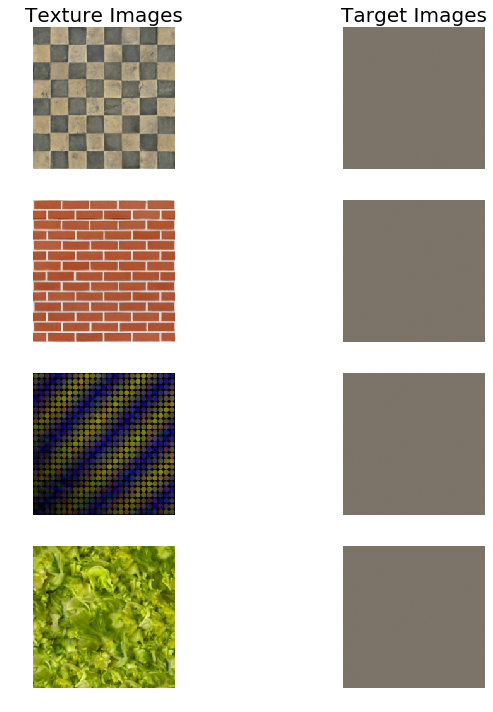

In [41]:
# display the images
num_textures = len(texture)
fig, axs = plt.subplots(num_pairs, 2, figsize=(10, 10))

axs[0, 0].set_title('Texture Images', fontsize=20)
axs[0, 1].set_title('Target Images', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(texture[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

In [0]:
# weights and parameters (cf. Table 1 in the paper [2])

# alpha, beta, gamma and delta corresponding to the loss weights for E_Grm, E_DCor, E_Div and E_Smooth
alpha = 0.5
beta = 0.5
gamma = -1.0e-4
delta = -0.75e-3

gram_layer_weights = {'pool1': 0.25,
                      'pool2': 0.25,
                      'pool3': 0.25,
                      'pool4': 0.25}

dcor_layer_weights = {'pool2': 1}
div_layer_weights = {'pool2': 1}
smooth_layer_weights = {'conv1': 1}

sigma = 1.0e-3

In [0]:
# get texture features only once before training
texture_features = [get_features(t, vgg, layers_deepcorr) for t in texture]
#style_features = [get_features(s, vgg) for s in style]

# calculate gram matrices G
texture_grams = [{layer: gram_matrix(t[layer]) for layer in t if layer in gram_layer_weights} for t in texture_features]

# calculate deep correlation matrices R
texture_dcors = [{layer: deep_corr_matrix_stack(t[layer]) for layer in t if layer in dcor_layer_weights} for t in texture_features]

# pick features for E_Div
texture_divs = [{layer: t[layer] for layer in t if layer in div_layer_weights} for t in texture_features]

# pick features for E_Smooth
texture_smooths = [{layer: t[layer] for layer in t if layer in smooth_layer_weights} for t in texture_features]

## Task 10: Texture Synthesis Function (10 points - 4 examples, 2.5 points each)

Complete the texture synthesis function below. Note that we do not use the Adam optmizer this time but LBFGS.

In [0]:
def texture_synthesis_lbfgs(tex_idx, lr = 1):

    # for displaying the target image, intermittently
    save_every = 10
    print_every = 10
    
    def closure():
        print('xxxx')

        # get the features from your target image
        target_features = get_features(target[tex_idx], vgg, layers_deepcorr)

        # E_Grm
        E_Grm = 0
        if alpha != 0:
            for layer in gram_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()
                
                # TODO Task 10: Compute E_l_Grm as defined in [2]
                target_gram = gram_matrix(target_feature)
                texture_gram = texture_grams[tex_idx][layer]
                E_l_Grm = torch.sum(((target_gram-texture_gram)**2).view(-1)) / (2*d*Q*M)**2 
                
                E_Grm = E_Grm + gram_layer_weights[layer] * E_l_Grm
#         E_Grm = E_Grm       
        # E_DCor
        E_DCor = 0
        if beta != 0:
            for layer in dcor_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()

                # TODO Task 10: Compute E_l_Dcor as defined in [2]
                target_dcor = deep_corr_matrix_stack(target_feature) # target_dcor is a three-dimensions tensor object
                texture_dcor = texture_dcors[tex_idx][layer] # the size of texture_dcor??? three dimensions?
                E_l_Dcor_difference = torch.sum(((target_dcor-texture_dcor)**2).view(-1))
                E_l_Dcor = E_l_Dcor_difference / 4

                E_DCor = E_DCor + dcor_layer_weights[layer] * E_l_Dcor
    
        # E_Div
        E_Div = 0
        if gamma != 0:
            for layer in div_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()
                
                # TODO Task 10: Compute E_l_Div as defined in [2]
                target_div = target_feature.view(-1)
                texture_div = texture_divs[tex_idx][layer].view(-1) # what's the shape of texture_div?
                
                E_l_Div = torch.sum((target_div-texture_div)**2)/2

                E_Div = E_Div + div_layer_weights[layer] * E_l_Div

        # E_Smooth
        E_Smooth = 0
        if delta != 0:
            for layer in smooth_layer_weights:
                
                # TODO Task 10: Compute E_l_Smooth as shown in Appendix B
                target_feature = target_features[layer]
                E_l_Smooth = E_smooth(target_feature)  

                E_Smooth = E_Smooth + smooth_layer_weights[layer] * E_l_Smooth

        # calculate the *total* loss
        
        # TODO Task 10: Compute the total loss as defined in [2] and shown in Appendix B
        total_loss = alpha * E_Grm + beta * E_DCor + gamma * E_Div + delta * E_Smooth

        # update your target image
        optimizer.zero_grad()
        total_loss.backward()
        # optimizer.step()
        return total_loss

    # iteration hyperparameters
    start = time.time()
    
    # Similar to the reference implementation by the authors of [2], we use LBFGS this time to optimize our texture
    
    # torch.optim.LBFGS(params, lr=1, max_iter=20, max_eval=None, tolerance_grad=1e-05, tolerance_change=1e-09, history_size=100, line_search_fn=None)
    optimizer = optim.LBFGS([target[tex_idx]], lr=lr, max_iter=300)
    optimizer.step(closure)

    end = time.time()
    print('Total Time [s]: ', (end - start))
    
    return target[tex_idx]

In [0]:
# Reset Targets to Noise if they have changed

target = [white_gauss_noise((t.shape[0], t.shape[1], t.shape[2], t.shape[3]), mu = 0, sigma = 0.001).to(device).requires_grad_(True) for t in texture]

## Task 11: Texture Synthesis (5 points, 1.25 points each)
Test you implementation for texture synthesis on four examples. Report the total time for synthesis together with the results.

In [0]:
# Texture Synthesis of a texture that is similar to target[0]   Total Time [s]:  75.11974048614502
tex_0 = texture_synthesis_lbfgs(0)

In [0]:
# Texture Synthesis of a texture that is similar to target[1]    Total Time [s]:  75.04310369491577
tex_1 = texture_synthesis_lbfgs(1)

In [0]:
# Texture Synthesis of a texture that is similar to target[2]     Total Time [s]:  75.02849745750427
tex_2 = texture_synthesis_lbfgs(2)   

In [0]:
# Texture Synthesis of a texture that is similar to target[3]   Total Time [s]:  74.83323860168457
tex_3 = texture_synthesis_lbfgs(3)

In [0]:
# Save results to hard disc
result_to_hd(tex_0, "tex0_ref.jpg")
result_to_hd(tex_1, "tex1_ref.jpg")
result_to_hd(tex_2, "tex2_ref.jpg")
result_to_hd(tex_3, "tex3_ref.jpg")

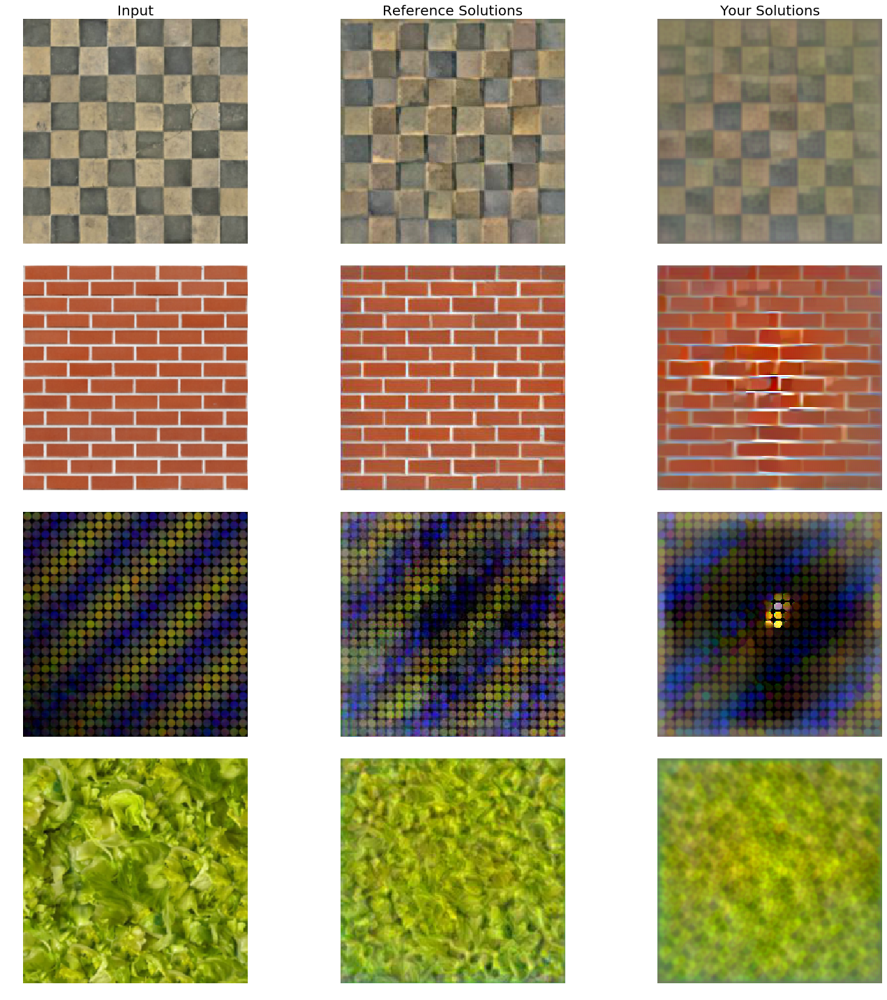

In [59]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 3, figsize=(20, 20))

axs[0, 0].set_title('Input', fontsize=20)
axs[0, 1].set_title('Reference Solutions', fontsize=20)
axs[0, 2].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(texture[row]))
        axs[row, 1].imshow(im_convert(ref_tex[row]))
        axs[row, 2].imshow(im_convert(target[row]))

        for col in range(0, 3):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

## Useful Commands
* For the computation of the gram matrix a stretching of each 2d activation map into a vector is required, this can be easily done by applying the [torch.Tensor.view](https://pytorch.org/docs/stable/tensors.html#torch.Tensor.view) command.
* The transpose of a torch matrix can be obtained using [torch.Tensor.transpose](https://pytorch.org/docs/stable/tensors.html?#torch.Tensor.transpose)
* Two torch matrices (tensors with 2 dimensions, a height and a width) can be multiplied using [torch.mm](https://pytorch.org/docs/stable/torch.html#torch.mm)
* The scalar mean of an arbitrary shaped tensor can be computed using [torch.mean](https://pytorch.org/docs/stable/torch.html#torch.mean)
* The dimensionality of a tensor (`batch_size`, `num_channels`, `height`, `width`) can be queried using [torch.Tensor.size](https://pytorch.org/docs/stable/tensors.html?highlight=size#torch.Tensor.size)
* A subsection of a Pytorch tensor can be obtained by using the [torch.narrow](https://pytorch.org/docs/stable/torch.html#torch.narrow) command or by referring to the desired subsection with a command similar to `tensor[:, :, 1:, :]`. In this example, one would obtain a slice with the first index of the third dimension removed.

## References


[1]	Gatys, Ecker, and Bethge, “Image Style Transfer Using Convolutional Neural Networks”,
CVPR 2016, [Paper](https://ieeexplore.ieee.org/document/7780634)

[2]	Sendik, and Cohen-Or, “Deep Correlations for Texture synthesis”, Siggraph 2017, [Paper](https://dl.acm.org/citation.cfm?id=3015461)

[3]	torchvision.models, https://pytorch.org/docs/stable/torchvision/models.html

[4]	Gramian Matrix, https://en.wikipedia.org/wiki/Gramian_matrix

## Appendix A - Details of [1]

Let $N_l$ be the number of feature maps at layer $l$ and let $M_l$ be the number of scalar values in each feature map, hence the height times the width of each feature map at layer $l$. By stretching the $2d$ responses in each feature map into a $1d$ vector, the responses at layer $l$ can therefore be stored in a matrix $F^l \in \mathbb{R}^{N_l \times M_l}$ where $F^l_{ij}$ is the activation value of the $i^{th}$ filter at position $j$ in layer $l$. Let further be $P^l$ and $F^l$ the feature representations of the content image $\vec{p}$ and the target image $\vec{x}$ in layer $l$ respectively.

#### Content Loss

Since we want to keep the content of $\vec{p}$ in our target image $\vec{x}$, it is a reasonable choice to minimize the squared difference between their corresponding activations $P^l$ and $F^l$. Recall that in higher layers of a neural network, detailed pixel information about the input image is usually lost, while information about the high-level content is preserved. In order to preserve the content it is therefore a good idea to choose a layer number corresponding to one of the higher layers $l$ (e.g. corresponding to `conv4_2` in VGG19) to define the content loss $\mathcal{L}_{\textrm{content}}$:


$$ \mathcal{L}_{\textrm{content}} \left( \vec{p}, \vec{x},l \right) = \frac{1}{N_l M_l} \sum_{i,j} \left( F^l_{ij} - P^l_{ij} \right)^2 = \textrm{mean}\left( \left( F^l - P^l \right) \odot \left( F^l - P^l \right) \right)$$

Note that this definition is slightly different from the original paper [1]. It is however highly recommended to take the mean of the sum of squares to be independet to the extent of the respective layer $l$.

##### Gram matrix

In order to preserve the style of the style image a we can not directly compare the feature maps of $\vec{a}$ and $\vec{x}$, but we can (as described in [1]) compare feature correlations which are given by the Gram matrix [4] $G^l \in \mathbb{R}^{N_l \times N_l}$ where $G^l_{ij}$ is the inner product between the vectorised feature maps $i$ and $j$ in layer $l$:

$$G^l_{ij} = \sum_{k} F^l_{ik} F^l_{jk}$$

#### Style Loss

We obtain a multi-scale representation of the style image by taking several layers l into account. Let $A^l$ and $G^l$ be the style representations (given by the corresponding Gram matrix) of the style image $\vec{a}$ and the target image $\vec{x}$ respectively, the contribution of layer $l$ to the style loss can then be defined as

$$ E_l = \frac{1}{N^2_l M^2_l} \sum_{i,j} \left( G^l_{ij} - A^l_{ij} \right)^2 = \frac{1}{M_l^2} \textrm{mean}\left( \left( G^l - A^l \right) \odot \left( G^l - A^l \right) \right) $$

Note that this definition of the style loss is also a bit different from from the paper.

By choosing a suitable weight $w_l$ for each layer $l$ we obtain the style loss $\mathcal{L}_{\textrm{style}}$ as

$$ \mathcal{L}_{\textrm{style}} \left( \vec{a}, \vec{x} \right) = \sum_{l=0}^{L} w_l E_l $$

The total loss is simply a weighted sum of the content loss and the style loss:

$$ \mathcal{L}_{\textrm{total}} \left( \vec{p}, \vec{a}, \vec{x} \right) = \alpha \mathcal{L}_{\textrm{content}} \left( \vec{p}, \vec{x} \right) + \beta \mathcal{L}_{\textrm{style}} \left( \vec{a}, \vec{x} \right) $$

Although this has not to be done in code explicitly, it is highly recommended to verify that the necessary gradients $\frac{\partial \mathcal{L}_{\textrm{content}}}{\partial F^l_{ij}}$ and $\frac{\partial E_l}{\partial F^l_{ij}}$, both with respect to the activations in the layer $l$, can be analytically derived as

$$\frac{\partial \mathcal{L}_{\textrm{content}}}{\partial F^l_{ij}} = \begin{cases} \begin{array}{lr} \frac{2}{N_l M_l} \left( F^l - P^l \right)_{ij} & \textrm{if} \; F^l_{ij}>0 \\ 0 & \textrm{if} \; F^l_{ij} \leq 0 \end{array} \end{cases}$$

$$\frac{\partial E_l}{\partial F^l_{ij}} = \begin{cases} \begin{array}{lr} \frac{2}{N_l^2 M^2_l} \left( \left( F^l \right)^T \left( G^l - A^l \right) \right)_{ji} & \textrm{if} \; F^l_{ij}>0 \\ 0 & \textrm{if} \; F^l_{ij} \leq 0 \end{array} \end{cases}$$

## Appendix B - Details of [2]

The approach presented in [2] is very similar to the method proposed in [1], the main contribution is the computation of the *deep correlation matrices* to obtain results that are similar to the input image both on a local and a global scale. For completeness (and in the case of $E^l_{smooth}$ for error correction), the essential equations of the proposed method are presented in the following.

$$E^l_{smooth} = \frac{1}{2 \sigma} \sum_{i,j,n} \textrm{log} \left( \frac{1}{4} \sum_{\delta i, \delta j} \textrm{exp} \left( -\sigma \cdot \left( f^{l,n}_{i,j} - f^{l,n}_{i + \delta i, j + \delta j} \right)^2 \right) \right)$$

$$E_{smooth} = \sum_{l} w^S_l E^l_{Smoooth}$$